# Regression Predict Student Solution

© Explore Data Science Academy

---
### Honour Code

I, 
- **Donald Nkabinde**, 
- **Kobus Leach**,
- **Insert name here**,
- **Insert name here**,
- **Insert name here**,

confirm - by submitting this document - that the solutions in this notebook are a result of my own work and that I abide by the [EDSA honour code](https://drive.google.com/file/d/1QDCjGZJ8-FmJE3bZdIQNwnJyQKPhHZBn/view?usp=sharing).

Non-compliance with the honour code constitutes a material breach of contract.

### Predict Overview: Spain Electricity Shortfall Challenge

The government of Spain is considering an expansion of it's renewable energy resource infrastructure investments. As such, they require information on the trends and patterns of the countries renewable sources and fossil fuel energy generation. Your company has been awarded the contract to:

- 1. analyse the supplied data;
- 2. identify potential errors in the data and clean the existing data set;
- 3. determine if additional features can be added to enrich the data set;
- 4. build a model that is capable of forecasting the three hourly demand shortfalls;
- 5. evaluate the accuracy of the best machine learning model;
- 6. determine what features were most important in the model’s prediction decision, and
- 7. explain the inner working of the model to a non-technical audience.

Formally the problem statement was given to you, the senior data scientist, by your manager via email reads as follow:

> In this project you are tasked to model the shortfall between the energy generated by means of fossil fuels and various renewable sources - for the country of Spain. The daily shortfall, which will be referred to as the target variable, will be modelled as a function of various city-specific weather features such as `pressure`, `wind speed`, `humidity`, etc. As with all data science projects, the provided features are rarely adequate predictors of the target variable. As such, you are required to perform feature engineering to ensure that you will be able to accurately model Spain's three hourly shortfalls.
 
On top of this, she has provided you with a starter notebook containing vague explanations of what the main outcomes are. 

<a id="cont"></a>

## Table of Contents

<a href=#one>1. Importing Packages</a>

<a href=#two>2. Loading Data</a>

<a href=#three>3. Exploratory Data Analysis (EDA)</a>

<a href=#four>4. Data Engineering</a>

<a href=#five>5. Modeling</a>

<a href=#six>6. Model Performance</a>

<a href=#seven>7. Model Explanations</a>

 <a id="one"></a>
## 1. Importing Packages
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Importing Packages ⚡ |
| :--------------------------- |
| In this section you are required to import, and briefly discuss, the libraries that will be used throughout your analysis and modelling. |

---

In [1]:
# Libraries for data loading, data manipulation and data visulisation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Libraries for data preparation and model building
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

# Setting global constants to ensure notebook results are reproducible
# PARAMETER_CONSTANT = ###

pd.set_option("display.max_rows", None) # to see all rows for the stats part
pd.set_option("display.max_columns", None) # to see all columns for the stats part

For this task, exploritory data analysis (EDA) will be utilised to analyse and explore the data to reveal insights, patterns, correlation, etc. This activity will reveal relevant features that will be used to create a model/models capable of forecasting the three hourly demand shortfalls. The following Python libraries will be used for this:

- **[Numpy](https://numpy.org/)**: NumPy is a fundamental library for numerical computing in Python. It provides efficient array manipulation and mathematical operations, making it essential for many scientific computations.

- **[Pandas](https://pandas.pydata.org/)**: Pandas is a powerful library for data manipulation and analysis. It offers data structures like DataFrames that allow for easy handling, cleaning, and exploration of structured data.

- **[Matplotlib](https://matplotlib.org/)**: Matplotlib is a plotting library that enables the creation of various types of visualisations, such as line plots, scatter plots, histograms, and more. It provides flexibility and customisation options for creating publication-quality figures.

- **[Seaborn](https://seaborn.pydata.org/)**: Seaborn is a data visualisation library built on top of Matplotlib. It provides a simplified interface for creating attractive statistical graphics, including heatmaps, violin plots, and joint plots.

- **[Scikit-learn](https://scikit-learn.org/stable/)**: Scikit-learn is a machine learning library that offers a wide range of algorithms for classification, regression, clustering, and dimensionality reduction. It provides an easy-to-use API for model training, evaluation, and prediction.

<a id="two"></a>
## 2. Loading the Data
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Loading the data ⚡ |
| :--------------------------- |
| In this section you are required to load the data from the `df_train` file into a DataFrame. |

---

In [2]:
df_train = pd.read_csv("df_train.csv")
df_train.head()

,Unnamed: 0,time,Madrid_wind_speed,Valencia_wind_deg,Bilbao_rain_1h,Valencia_wind_speed,Seville_humidity,Madrid_humidity,Bilbao_clouds_all,Bilbao_wind_speed,Seville_clouds_all,Bilbao_wind_deg,Barcelona_wind_speed,Barcelona_wind_deg,Madrid_clouds_all,Seville_wind_speed,Barcelona_rain_1h,Seville_pressure,Seville_rain_1h,Bilbao_snow_3h,Barcelona_pressure,Seville_rain_3h,Madrid_rain_1h,Barcelona_rain_3h,Valencia_snow_3h,Madrid_weather_id,Barcelona_weather_id,Bilbao_pressure,Seville_weather_id,Valencia_pressure,Seville_temp_max,Madrid_pressure,Valencia_temp_max,Valencia_temp,Bilbao_weather_id,Seville_temp,Valencia_humidity,Valencia_temp_min,Barcelona_temp_max,Madrid_temp_max,Barcelona_temp,Bilbao_temp_min,Bilbao_temp,Barcelona_temp_min,Bilbao_temp_max,Seville_temp_min,Madrid_temp,Madrid_temp_min,load_shortfall_3h
0,0,2015-01-01 03:00:00,0.666667,level_5,0.0,0.666667,74.333333,64.000000,0.0,1.000000,0.0,223.333333,6.333333,42.666667,0.0,3.333333,0.0,sp25,0.0,0.0,1036.333333,0.0,0.0,0.0,0.0,800.0,800.0,1035.000000,800.0,1002.666667,274.254667,971.333333,269.888000,269.888000,800.0,274.254667,75.666667,269.888000,281.013000,265.938000,281.013000,269.338615,269.338615,281.013000,269.338615,274.254667,265.938000,265.938000,6715.666667
1,1,2015-01-01 06:00:00,0.333333,level_10,0.0,1.666667,78.333333,64.666667,0.0,1.000000,0.0,221.000000,4.000000,139.000000,0.0,3.333333,0.0,sp25,0.0,0.0,1037.333333,0.0,0.0,0.0,0.0,800.0,800.0,1035.666667,800.0,1004.333333,274.945000,972.666667,271.728333,271.728333,800.0,274.945000,71.000000,271.728333,280.561667,266.386667,280.561667,270.376000,270.376000,280.561667,270.376000,274.945000,266.386667,266.386667,4171.666667
2,2,2015-01-01 09:00:00,1.000000,level_9,0.0,1.000000,71.333333,64.333333,0.0,1.000000,0.0,214.333333,2.000000,326.000000,0.0,2.666667,0.0,sp25,0.0,0.0,1038.000000,0.0,0.0,0.0,0.0,800.0,800.0,1036.000000,800.0,1005.333333,278.792000,974.000000,278.008667,278.008667,800.0,278.792000,65.666667,278.008667,281.583667,272.708667,281.583667,275.027229,275.027229,281.583667,275.027229,278.792000,272.708667,272.708667,4274.666667
3,3,2015-01-01 12:00:00,1.000000,level_8,0.0,1.000000,65.333333,56.333333,0.0,1.000000,0.0,199.666667,2.333333,273.000000,0.0,4.000000,0.0,sp25,0.0,0.0,1037.000000,0.0,0.0,0.0,0.0,800.0,800.0,1036.000000,800.0,1009.000000,285.394000,994.666667,284.899552,284.899552,800.0,285.394000,54.000000,284.899552,283.434104,281.895219,283.434104,281.135063,281.135063,283.434104,281.135063,285.394000,281.895219,281.895219,5075.666667
4,4,2015-01-01 15:00:00,1.000000,level_7,0.0,1.000000,59.000000,57.000000,2.0,0.333333,0.0,185.000000,4.333333,260.000000,0.0,3.000000,0.0,sp25,0.0,0.0,1035.000000,0.0,0.0,0.0,0.0,800.0,800.0,1035.333333,800.0,NaN,285.513719,1035.333333,283.015115,283.015115,800.0,285.513719,58.333333,283.015115,284.213167,280.678437,284.213167,282.252063,282.252063,284.213167,282.252063,285.513719,280.678437,280.678437,6620.666667


<a id="three"></a>
## 3. Exploratory Data Analysis (EDA)
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Exploratory data analysis ⚡ |
| :--------------------------- |
| In this section, you are required to perform an in-depth analysis of all the variables in the DataFrame. |

---


In [3]:
df_train.shape

(8763, 49)

Our train dataset comprises of 8763 entries, and 48 features + the target feature (load_shortfall_3h). In total, there are 49 features with the following names:

In [32]:
df_train.columns

Index(['Date_Time', 'Month', 'Season', 'Clouds_all_Bilboa',
       'Clouds_all_Madrid', 'Clouds_all_Seville', 'Humidity_Madrid',
       'Humidity_Seville', 'Humidity_Valencia', 'Pressure_Barcelona',
       'Pressure_Bilboa', 'Pressure_Madrid', 'Pressure_Seville',
       'Pressure_Valencia', 'Rain_1h_Barcelona', 'Rain_1h_Bilboa',
       'Rain_1h_Madrid', 'Rain_1h_Seville', 'Rain_3h_Barcelona',
       'Rain_3h_Seville', 'Snow_3h_Bilboa', 'Snow_3h_Valencia',
       'Temp_max_Barcelona', 'Temp_max_Bilboa', 'Temp_max_Madrid',
       'Temp_max_Seville', 'Temp_max_Valencia', 'Temp_min_Barcelona',
       'Temp_min_Bilboa', 'Temp_min_Madrid', 'Temp_min_Seville',
       'Temp_min_Valencia', 'Temperature_Barcelona', 'Temperature_Bilboa',
       'Temperature_Madrid', 'Temperature_Seville', 'Temperature_Valencia',
       'Weather_id_Barcelona', 'Weather_id_Bilboa', 'Weather_id_Madrid',
       'Weather_id_Seville', 'Wind_direction_Barcelona',
       'Wind_direction_Bilboa', 'Wind_direction_Valencia'

Before we start with the statistical analysis, we explore the missing values in each of the columns:

In [33]:
df_train.isnull().sum()

Date_Time                   0
Month                       0
Season                      0
Clouds_all_Bilboa           0
Clouds_all_Madrid           0
Clouds_all_Seville          0
Humidity_Madrid             0
Humidity_Seville            0
Humidity_Valencia           0
Pressure_Barcelona          0
Pressure_Bilboa             0
Pressure_Madrid             0
Pressure_Seville            0
Pressure_Valencia           0
Rain_1h_Barcelona           0
Rain_1h_Bilboa              0
Rain_1h_Madrid              0
Rain_1h_Seville             0
Rain_3h_Barcelona           0
Rain_3h_Seville             0
Snow_3h_Bilboa              0
Snow_3h_Valencia            0
Temp_max_Barcelona          0
Temp_max_Bilboa             0
Temp_max_Madrid             0
Temp_max_Seville            0
Temp_max_Valencia           0
Temp_min_Barcelona          0
Temp_min_Bilboa             0
Temp_min_Madrid             0
Temp_min_Seville            0
Temp_min_Valencia           0
Temperature_Barcelona       0
Temperatur

The `Valencia_pressure` feature is the only feature with missing values and it is missing 2068 entries.

In [34]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8763 entries, 0 to 8762
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Date_Time                 8763 non-null   object 
 1   Month                     8763 non-null   int64  
 2   Season                    8763 non-null   int64  
 3   Clouds_all_Bilboa         8763 non-null   float64
 4   Clouds_all_Madrid         8763 non-null   float64
 5   Clouds_all_Seville        8763 non-null   float64
 6   Humidity_Madrid           8763 non-null   float64
 7   Humidity_Seville          8763 non-null   float64
 8   Humidity_Valencia         8763 non-null   float64
 9   Pressure_Barcelona        8763 non-null   float64
 10  Pressure_Bilboa           8763 non-null   float64
 11  Pressure_Madrid           8763 non-null   float64
 12  Pressure_Seville          8763 non-null   int64  
 13  Pressure_Valencia         8763 non-null   float64
 14  Rain_1h_

This reveals that there are 46 numerical features (45 of those have a `float64` datatype while only one of those is `int64`) and 3 non-numerical features. First exploring the numerical data we get:

In [35]:
# df_train.describe().T
with pd.option_context("float_format", '{:.1f}'.format): print(df_train.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean    std     min    25%     50%     75%     max
Month                        6.5    3.4     1.0    4.0     7.0    10.0    12.0
Season                       2.5    1.1     1.0    2.0     3.0     3.0     4.0
Clouds_all_Bilboa           43.5   32.6     0.0   10.0    45.0    75.0   100.0
Clouds_all_Madrid           19.5   28.1     0.0    0.0     0.0    33.3   100.0
Clouds_all_Seville          13.7   24.3     0.0    0.0     0.0    20.0    97.3
Humidity_Madrid             57.4   24.3     6.3   36.3    58.0    78.7   100.0
Humidity_Seville            62.7   22.6     8.3   44.3    65.7    82.0   100.0
Humidity_Valencia           65.2   19.3    10.3   51.3    67.0    81.3   100.0
Pressure_Barcelona        1018.0    7.4   934.7 1014.0  1018.0  1022.0  1039.0
Pressure_Bilboa           1017.7   10.0   971.3 1013.0  1019.0  1024.0  1042.0
Pressure_Madrid           1010.3   22.2   927.7 1012.3  1017.3  1022.0  1038.0
Pressure_Seville            13.5    7.2     1.0    7

From these description statistics, we see that the `Unnamed: 0` feature is actually an index so can be dropped from the dataframe leaving us with one less feature.

In [8]:
df_train = df_train.drop(["Unnamed: 0"], axis = 1)
df_train.head()

,time,Madrid_wind_speed,Valencia_wind_deg,Bilbao_rain_1h,Valencia_wind_speed,Seville_humidity,Madrid_humidity,Bilbao_clouds_all,Bilbao_wind_speed,Seville_clouds_all,Bilbao_wind_deg,Barcelona_wind_speed,Barcelona_wind_deg,Madrid_clouds_all,Seville_wind_speed,Barcelona_rain_1h,Seville_pressure,Seville_rain_1h,Bilbao_snow_3h,Barcelona_pressure,Seville_rain_3h,Madrid_rain_1h,Barcelona_rain_3h,Valencia_snow_3h,Madrid_weather_id,Barcelona_weather_id,Bilbao_pressure,Seville_weather_id,Valencia_pressure,Seville_temp_max,Madrid_pressure,Valencia_temp_max,Valencia_temp,Bilbao_weather_id,Seville_temp,Valencia_humidity,Valencia_temp_min,Barcelona_temp_max,Madrid_temp_max,Barcelona_temp,Bilbao_temp_min,Bilbao_temp,Barcelona_temp_min,Bilbao_temp_max,Seville_temp_min,Madrid_temp,Madrid_temp_min,load_shortfall_3h
0,2015-01-01 03:00:00,0.666667,level_5,0.0,0.666667,74.333333,64.000000,0.0,1.000000,0.0,223.333333,6.333333,42.666667,0.0,3.333333,0.0,sp25,0.0,0.0,1036.333333,0.0,0.0,0.0,0.0,800.0,800.0,1035.000000,800.0,1002.666667,274.254667,971.333333,269.888000,269.888000,800.0,274.254667,75.666667,269.888000,281.013000,265.938000,281.013000,269.338615,269.338615,281.013000,269.338615,274.254667,265.938000,265.938000,6715.666667
1,2015-01-01 06:00:00,0.333333,level_10,0.0,1.666667,78.333333,64.666667,0.0,1.000000,0.0,221.000000,4.000000,139.000000,0.0,3.333333,0.0,sp25,0.0,0.0,1037.333333,0.0,0.0,0.0,0.0,800.0,800.0,1035.666667,800.0,1004.333333,274.945000,972.666667,271.728333,271.728333,800.0,274.945000,71.000000,271.728333,280.561667,266.386667,280.561667,270.376000,270.376000,280.561667,270.376000,274.945000,266.386667,266.386667,4171.666667
2,2015-01-01 09:00:00,1.000000,level_9,0.0,1.000000,71.333333,64.333333,0.0,1.000000,0.0,214.333333,2.000000,326.000000,0.0,2.666667,0.0,sp25,0.0,0.0,1038.000000,0.0,0.0,0.0,0.0,800.0,800.0,1036.000000,800.0,1005.333333,278.792000,974.000000,278.008667,278.008667,800.0,278.792000,65.666667,278.008667,281.583667,272.708667,281.583667,275.027229,275.027229,281.583667,275.027229,278.792000,272.708667,272.708667,4274.666667
3,2015-01-01 12:00:00,1.000000,level_8,0.0,1.000000,65.333333,56.333333,0.0,1.000000,0.0,199.666667,2.333333,273.000000,0.0,4.000000,0.0,sp25,0.0,0.0,1037.000000,0.0,0.0,0.0,0.0,800.0,800.0,1036.000000,800.0,1009.000000,285.394000,994.666667,284.899552,284.899552,800.0,285.394000,54.000000,284.899552,283.434104,281.895219,283.434104,281.135063,281.135063,283.434104,281.135063,285.394000,281.895219,281.895219,5075.666667
4,2015-01-01 15:00:00,1.000000,level_7,0.0,1.000000,59.000000,57.000000,2.0,0.333333,0.0,185.000000,4.333333,260.000000,0.0,3.000000,0.0,sp25,0.0,0.0,1035.000000,0.0,0.0,0.0,0.0,800.0,800.0,1035.333333,800.0,NaN,285.513719,1035.333333,283.015115,283.015115,800.0,285.513719,58.333333,283.015115,284.213167,280.678437,284.213167,282.252063,282.252063,284.213167,282.252063,285.513719,280.678437,280.678437,6620.666667


 Exploring the `object` datatype, we get the following features:

In [9]:
object_list = df_train.select_dtypes(include = ["object"]).columns.to_list()
object_list

['time', 'Valencia_wind_deg', 'Seville_pressure']

In [10]:
df_train[object_list].head()

,time,Valencia_wind_deg,Seville_pressure
0,2015-01-01 03:00:00,level_5,sp25
1,2015-01-01 06:00:00,level_10,sp25
2,2015-01-01 09:00:00,level_9,sp25
3,2015-01-01 12:00:00,level_8,sp25
4,2015-01-01 15:00:00,level_7,sp25


The three `object` features are the `'time'`, `'Valencia_wind_deg'`, and `'Seville_pressure'` columns. The `'Valencia_wind_deg'`, and `'Seville_pressure'` columns are coded instead of being provided as actual values. Looking at the pressure values from the numerical values, 

In [11]:
df_train['Month'] = pd.DatetimeIndex(df_train['time']).month

In [12]:
season_dict = {1: 1,
               2: 1,
               3: 2, 
               4: 2,
               5: 2,
               6: 3,
               7: 3,
               8: 3,
               9: 4,
               10: 4,
               11: 4,
               12: 1}
df_train['Season'] = df_train['Month'].apply(lambda x: season_dict[x])

In [13]:
columns_old = df_train.columns.values.tolist()
print(columns_old)
print(len(columns_old))

['time', 'Madrid_wind_speed', 'Valencia_wind_deg', 'Bilbao_rain_1h', 'Valencia_wind_speed', 'Seville_humidity', 'Madrid_humidity', 'Bilbao_clouds_all', 'Bilbao_wind_speed', 'Seville_clouds_all', 'Bilbao_wind_deg', 'Barcelona_wind_speed', 'Barcelona_wind_deg', 'Madrid_clouds_all', 'Seville_wind_speed', 'Barcelona_rain_1h', 'Seville_pressure', 'Seville_rain_1h', 'Bilbao_snow_3h', 'Barcelona_pressure', 'Seville_rain_3h', 'Madrid_rain_1h', 'Barcelona_rain_3h', 'Valencia_snow_3h', 'Madrid_weather_id', 'Barcelona_weather_id', 'Bilbao_pressure', 'Seville_weather_id', 'Valencia_pressure', 'Seville_temp_max', 'Madrid_pressure', 'Valencia_temp_max', 'Valencia_temp', 'Bilbao_weather_id', 'Seville_temp', 'Valencia_humidity', 'Valencia_temp_min', 'Barcelona_temp_max', 'Madrid_temp_max', 'Barcelona_temp', 'Bilbao_temp_min', 'Bilbao_temp', 'Barcelona_temp_min', 'Bilbao_temp_max', 'Seville_temp_min', 'Madrid_temp', 'Madrid_temp_min', 'load_shortfall_3h', 'Month', 'Season']
50


In [14]:
columns_new  = ['Date_Time', 'Wind_speed_Madrid', 'Wind_direction_Valencia', 'Rain_1h_Bilboa', 'Wind_speed_Valencia', 'Humidity_Seville', 'Humidity_Madrid', 'Clouds_all_Bilboa', 'Wind_speed_Bilboa', 'Clouds_all_Seville', 'Wind_direction_Bilboa', 'Wind_speed_Barcelona', 'Wind_direction_Barcelona', 'Clouds_all_Madrid', 'Wind_speed_Seville', 'Rain_1h_Barcelona', 'Pressure_Seville', 'Rain_1h_Seville', 'Snow_3h_Bilboa', 'Pressure_Barcelona', 'Rain_3h_Seville', 'Rain_1h_Madrid', 'Rain_3h_Barcelona', 'Snow_3h_Valencia', 'Weather_id_Madrid', 'Weather_id_Barcelona', 'Pressure_Bilboa', 'Weather_id_Seville', 'Pressure_Valencia', 'Temp_max_Seville', 'Pressure_Madrid', 'Temp_max_Valencia', 'Temperature_Valencia', 'Weather_id_Bilboa', 'Temperature_Seville', 'Humidity_Valencia', 'Temp_min_Valencia', 'Temp_max_Barcelona', 'Temp_max_Madrid', 'Temperature_Barcelona', 'Temp_min_Bilboa', 'Temperature_Bilboa', 'Temp_min_Barcelona', 'Temp_max_Bilboa', 'Temp_min_Seville', 'Temperature_Madrid', 'Temp_min_Madrid', 'Load_Shortfall_3h','Month','Season']
print(columns_new)
print(len(columns_new))

['Date_Time', 'Wind_speed_Madrid', 'Wind_direction_Valencia', 'Rain_1h_Bilboa', 'Wind_speed_Valencia', 'Humidity_Seville', 'Humidity_Madrid', 'Clouds_all_Bilboa', 'Wind_speed_Bilboa', 'Clouds_all_Seville', 'Wind_direction_Bilboa', 'Wind_speed_Barcelona', 'Wind_direction_Barcelona', 'Clouds_all_Madrid', 'Wind_speed_Seville', 'Rain_1h_Barcelona', 'Pressure_Seville', 'Rain_1h_Seville', 'Snow_3h_Bilboa', 'Pressure_Barcelona', 'Rain_3h_Seville', 'Rain_1h_Madrid', 'Rain_3h_Barcelona', 'Snow_3h_Valencia', 'Weather_id_Madrid', 'Weather_id_Barcelona', 'Pressure_Bilboa', 'Weather_id_Seville', 'Pressure_Valencia', 'Temp_max_Seville', 'Pressure_Madrid', 'Temp_max_Valencia', 'Temperature_Valencia', 'Weather_id_Bilboa', 'Temperature_Seville', 'Humidity_Valencia', 'Temp_min_Valencia', 'Temp_max_Barcelona', 'Temp_max_Madrid', 'Temperature_Barcelona', 'Temp_min_Bilboa', 'Temperature_Bilboa', 'Temp_min_Barcelona', 'Temp_max_Bilboa', 'Temp_min_Seville', 'Temperature_Madrid', 'Temp_min_Madrid', 'Load_Shor

In [15]:
df_train.columns = columns_new
print(df_train.columns)

Index(['Date_Time', 'Wind_speed_Madrid', 'Wind_direction_Valencia',
       'Rain_1h_Bilboa', 'Wind_speed_Valencia', 'Humidity_Seville',
       'Humidity_Madrid', 'Clouds_all_Bilboa', 'Wind_speed_Bilboa',
       'Clouds_all_Seville', 'Wind_direction_Bilboa', 'Wind_speed_Barcelona',
       'Wind_direction_Barcelona', 'Clouds_all_Madrid', 'Wind_speed_Seville',
       'Rain_1h_Barcelona', 'Pressure_Seville', 'Rain_1h_Seville',
       'Snow_3h_Bilboa', 'Pressure_Barcelona', 'Rain_3h_Seville',
       'Rain_1h_Madrid', 'Rain_3h_Barcelona', 'Snow_3h_Valencia',
       'Weather_id_Madrid', 'Weather_id_Barcelona', 'Pressure_Bilboa',
       'Weather_id_Seville', 'Pressure_Valencia', 'Temp_max_Seville',
       'Pressure_Madrid', 'Temp_max_Valencia', 'Temperature_Valencia',
       'Weather_id_Bilboa', 'Temperature_Seville', 'Humidity_Valencia',
       'Temp_min_Valencia', 'Temp_max_Barcelona', 'Temp_max_Madrid',
       'Temperature_Barcelona', 'Temp_min_Bilboa', 'Temperature_Bilboa',
       'Temp_mi

In [16]:
first_col = [columns_new[0]]
sort_col = sorted(columns_new[1:-3])
other_col = columns_new[-2:]
last_col = [columns_new[-3]]
cols = first_col + other_col + sort_col + last_col
print(cols)

['Date_Time', 'Month', 'Season', 'Clouds_all_Bilboa', 'Clouds_all_Madrid', 'Clouds_all_Seville', 'Humidity_Madrid', 'Humidity_Seville', 'Humidity_Valencia', 'Pressure_Barcelona', 'Pressure_Bilboa', 'Pressure_Madrid', 'Pressure_Seville', 'Pressure_Valencia', 'Rain_1h_Barcelona', 'Rain_1h_Bilboa', 'Rain_1h_Madrid', 'Rain_1h_Seville', 'Rain_3h_Barcelona', 'Rain_3h_Seville', 'Snow_3h_Bilboa', 'Snow_3h_Valencia', 'Temp_max_Barcelona', 'Temp_max_Bilboa', 'Temp_max_Madrid', 'Temp_max_Seville', 'Temp_max_Valencia', 'Temp_min_Barcelona', 'Temp_min_Bilboa', 'Temp_min_Madrid', 'Temp_min_Seville', 'Temp_min_Valencia', 'Temperature_Barcelona', 'Temperature_Bilboa', 'Temperature_Madrid', 'Temperature_Seville', 'Temperature_Valencia', 'Weather_id_Barcelona', 'Weather_id_Bilboa', 'Weather_id_Madrid', 'Weather_id_Seville', 'Wind_direction_Barcelona', 'Wind_direction_Bilboa', 'Wind_direction_Valencia', 'Wind_speed_Barcelona', 'Wind_speed_Bilboa', 'Wind_speed_Madrid', 'Wind_speed_Seville', 'Wind_speed_Va

In [17]:
df_train = df_train[cols]
df_train.head()

,Date_Time,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_direction_Valencia,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,0.0,0.0,0.0,64.000000,74.333333,75.666667,1036.333333,1035.000000,971.333333,sp25,1002.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,281.013000,269.338615,265.938000,274.254667,269.888000,281.013000,269.338615,265.938000,274.254667,269.888000,281.013000,269.338615,265.938000,274.254667,269.888000,800.0,800.0,800.0,800.0,42.666667,223.333333,level_5,6.333333,1.000000,0.666667,3.333333,0.666667,6715.666667
1,2015-01-01 06:00:00,1,1,0.0,0.0,0.0,64.666667,78.333333,71.000000,1037.333333,1035.666667,972.666667,sp25,1004.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,280.561667,270.376000,266.386667,274.945000,271.728333,280.561667,270.376000,266.386667,274.945000,271.728333,280.561667,270.376000,266.386667,274.945000,271.728333,800.0,800.0,800.0,800.0,139.000000,221.000000,level_10,4.000000,1.000000,0.333333,3.333333,1.666667,4171.666667
2,2015-01-01 09:00:00,1,1,0.0,0.0,0.0,64.333333,71.333333,65.666667,1038.000000,1036.000000,974.000000,sp25,1005.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,281.583667,275.027229,272.708667,278.792000,278.008667,281.583667,275.027229,272.708667,278.792000,278.008667,281.583667,275.027229,272.708667,278.792000,278.008667,800.0,800.0,800.0,800.0,326.000000,214.333333,level_9,2.000000,1.000000,1.000000,2.666667,1.000000,4274.666667
3,2015-01-01 12:00:00,1,1,0.0,0.0,0.0,56.333333,65.333333,54.000000,1037.000000,1036.000000,994.666667,sp25,1009.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,283.434104,281.135063,281.895219,285.394000,284.899552,283.434104,281.135063,281.895219,285.394000,284.899552,283.434104,281.135063,281.895219,285.394000,284.899552,800.0,800.0,800.0,800.0,273.000000,199.666667,level_8,2.333333,1.000000,1.000000,4.000000,1.000000,5075.666667
4,2015-01-01 15:00:00,1,1,2.0,0.0,0.0,57.000000,59.000000,58.333333,1035.000000,1035.333333,1035.333333,sp25,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,284.213167,282.252063,280.678437,285.513719,283.015115,284.213167,282.252063,280.678437,285.513719,283.015115,284.213167,282.252063,280.678437,285.513719,283.015115,800.0,800.0,800.0,800.0,260.000000,185.000000,level_7,4.333333,0.333333,1.000000,3.000000,1.000000,6620.666667


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


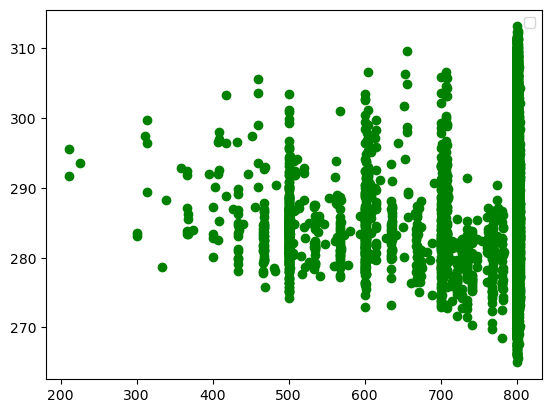

In [18]:
plt.scatter(df_train["Weather_id_Madrid"],df_train["Temperature_Madrid"], color='green')
plt.legend()
plt.show()

In [19]:
outlier_up = len(df_train[df_train['Pressure_Barcelona'] > 1070])
print(outlier_up)
outlier_low = len(df_train[df_train['Pressure_Barcelona'] < 920])
print(outlier_low)

18
3


In [20]:
pressure_bar_mean = df_train['Pressure_Barcelona'][df_train['Pressure_Barcelona'].between(920,1070)].mean()
pressure_bar_std = df_train['Pressure_Barcelona'][df_train['Pressure_Barcelona'].between(920,1070)].std()
print(pressure_bar_mean)
print(pressure_bar_std)

1017.9653206741409
7.456559698954482


In [21]:
df_train['Pressure_Barcelona'] = np.where((df_train['Pressure_Barcelona'] > 1070) | (df_train['Pressure_Barcelona'] < 920), pressure_bar_mean, df_train['Pressure_Barcelona'])
1
df_train['Pressure_Barcelona'] = np.where((df_train['Pressure_Barcelona'] > 1070) | (df_train['Pressure_Barcelona'] < 920), pressure_bar_mean, df_train['Pressure_Barcelona'])

In [22]:
df_train["Pressure_Madrid"].groupby(pd.cut(df_train['Pressure_Madrid'], np.arange(920,1070,15))).count()

Pressure_Madrid
(920, 935]        24
(935, 950]       177
(950, 965]       767
(965, 980]       250
(980, 995]        54
(995, 1010]      523
(1010, 1025]    5795
(1025, 1040]    1173
(1040, 1055]       0
Name: Pressure_Madrid, dtype: int64

In [23]:
df_train["Pressure_Bilboa"].groupby(pd.cut(df_train['Pressure_Bilboa'], np.arange(920,1070,15))).count()

Pressure_Bilboa
(920, 935]         0
(935, 950]         0
(950, 965]         0
(965, 980]        41
(980, 995]       265
(995, 1010]     1219
(1010, 1025]    5533
(1025, 1040]    1692
(1040, 1055]      13
Name: Pressure_Bilboa, dtype: int64

In [24]:
df_train['Pressure_Barcelona'] = np.where((df_train['Pressure_Barcelona'] > 1070) | (df_train['Pressure_Barcelona'] < 920), pressure_bar_mean, df_train['Pressure_Barcelona'])

In [25]:
df_train["Pressure_Barcelona"].groupby(pd.cut(df_train['Pressure_Barcelona'], np.arange(920,1070,15))).count()

Pressure_Barcelona
(920, 935]         1
(935, 950]         0
(950, 965]         1
(965, 980]         1
(980, 995]        83
(995, 1010]      881
(1010, 1025]    6535
(1025, 1040]    1261
(1040, 1055]       0
Name: Pressure_Barcelona, dtype: int64

In [26]:
pressure_val_mean = df_train['Pressure_Valencia'][df_train['Pressure_Valencia'].between(920,1070)].mean()
print(pressure_val_mean)

1012.0514065222828


In [27]:
df_train.loc[df_train['Pressure_Valencia'].isna(),'Pressure_Valencia']=pressure_val_mean
df_train.head()

,Date_Time,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_direction_Valencia,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,0.0,0.0,0.0,64.000000,74.333333,75.666667,1036.333333,1035.000000,971.333333,sp25,1002.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,281.013000,269.338615,265.938000,274.254667,269.888000,281.013000,269.338615,265.938000,274.254667,269.888000,281.013000,269.338615,265.938000,274.254667,269.888000,800.0,800.0,800.0,800.0,42.666667,223.333333,level_5,6.333333,1.000000,0.666667,3.333333,0.666667,6715.666667
1,2015-01-01 06:00:00,1,1,0.0,0.0,0.0,64.666667,78.333333,71.000000,1037.333333,1035.666667,972.666667,sp25,1004.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,280.561667,270.376000,266.386667,274.945000,271.728333,280.561667,270.376000,266.386667,274.945000,271.728333,280.561667,270.376000,266.386667,274.945000,271.728333,800.0,800.0,800.0,800.0,139.000000,221.000000,level_10,4.000000,1.000000,0.333333,3.333333,1.666667,4171.666667
2,2015-01-01 09:00:00,1,1,0.0,0.0,0.0,64.333333,71.333333,65.666667,1038.000000,1036.000000,974.000000,sp25,1005.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,281.583667,275.027229,272.708667,278.792000,278.008667,281.583667,275.027229,272.708667,278.792000,278.008667,281.583667,275.027229,272.708667,278.792000,278.008667,800.0,800.0,800.0,800.0,326.000000,214.333333,level_9,2.000000,1.000000,1.000000,2.666667,1.000000,4274.666667
3,2015-01-01 12:00:00,1,1,0.0,0.0,0.0,56.333333,65.333333,54.000000,1037.000000,1036.000000,994.666667,sp25,1009.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,283.434104,281.135063,281.895219,285.394000,284.899552,283.434104,281.135063,281.895219,285.394000,284.899552,283.434104,281.135063,281.895219,285.394000,284.899552,800.0,800.0,800.0,800.0,273.000000,199.666667,level_8,2.333333,1.000000,1.000000,4.000000,1.000000,5075.666667
4,2015-01-01 15:00:00,1,1,2.0,0.0,0.0,57.000000,59.000000,58.333333,1035.000000,1035.333333,1035.333333,sp25,1012.051407,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,284.213167,282.252063,280.678437,285.513719,283.015115,284.213167,282.252063,280.678437,285.513719,283.015115,284.213167,282.252063,280.678437,285.513719,283.015115,800.0,800.0,800.0,800.0,260.000000,185.000000,level_7,4.333333,0.333333,1.000000,3.000000,1.000000,6620.666667


In [28]:
df_train["Pressure_Valencia"].groupby(pd.cut(df_train['Pressure_Valencia'], np.arange(920,1070,15))).count()

Pressure_Valencia
(920, 935]         0
(935, 950]         0
(950, 965]         0
(965, 980]        33
(980, 995]       663
(995, 1010]      921
(1010, 1025]    7146
(1025, 1040]       0
(1040, 1055]       0
Name: Pressure_Valencia, dtype: int64

In [29]:
df_train['Pressure_Seville'] = df_train['Pressure_Seville'].str.split('p').str.get(-1)
df_train['Pressure_Seville'] = pd.to_numeric(df_train['Pressure_Seville'])

In [30]:
df_train["Pressure_Seville"].groupby(pd.cut(df_train['Pressure_Seville'], np.arange(0,27.5,2.5))).count()

Pressure_Seville
(0.0, 2.5]       595
(2.5, 5.0]      1085
(5.0, 7.5]       585
(7.5, 10.0]     1061
(10.0, 12.5]     517
(12.5, 15.0]    1081
(15.0, 17.5]     793
(17.5, 20.0]    1092
(20.0, 22.5]     800
(22.5, 25.0]    1154
Name: Pressure_Seville, dtype: int64

In [31]:
df_train.corr()

,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia,Load_Shortfall_3h
Month,1.000000,0.574388,-0.117452,-0.118792,-0.170345,-0.076567,-0.111622,0.162713,0.193950,0.010533,0.269350,-0.036368,0.053704,-0.029252,-0.188274,-0.070592,-0.072631,-0.056726,-0.055265,-0.075644,-0.022720,0.230539,0.277963,0.191223,0.193143,0.210184,0.159629,0.195889,0.157368,0.205000,0.220501,0.203184,0.239443,0.182860,0.213623,0.216464,0.025352,0.141738,0.068856,0.100786,0.021463,-0.174941,-0.122221,-0.086698,-0.237445,-0.122624,-0.237156,0.199048
Season,0.574388,1.000000,-0.037711,-0.217232,-0.184436,-0.344818,-0.292314,0.042495,-0.096921,-0.214626,0.094014,-0.321763,0.050463,0.039031,-0.144427,-0.044203,-0.059126,-0.039804,-0.029696,-0.074332,-0.023356,0.543246,0.451982,0.472483,0.419200,0.492845,0.479905,0.450996,0.426441,0.477059,0.479553,0.527081,0.459051,0.467024,0.482373,0.491729,-0.024873,0.108194,0.082069,0.097999,-0.081097,-0.078052,-0.076571,-0.141810,-0.149807,-0.090860,-0.221606,0.176688
Clouds_all_Bilboa,-0.117452,-0.037711,1.000000,0.109788,0.046737,0.041878,0.061680,-0.129684,-0.335699,0.000377,-0.135672,-0.038859,-0.067832,0.052913,0.370733,0.089281,0.041090,-0.041013,0.009557,0.080180,0.024339,-0.034040,-0.158014,-0.048491,-0.102322,0.002621,-0.010804,-0.067731,-0.046189,-0.077417,-0.003806,-0.023171,-0.114118,-0.046686,-0.095003,-0.000299,-0.124169,-0.536205,-0.080837,-0.033825,-0.065120,0.280154,0.094019,0.031915,0.244001,0.075066,0.210524,-0.127293
Clouds_all_Madrid,-0.118792,-0.217232,0.109788,1.000000,0.552414,0.484293,0.366602,0.066366,-0.233140,-0.323787,-0.190070,-0.068510,-0.194446,0.008570,0.135524,0.402147,0.302665,-0.000355,0.077246,0.041997,0.023323,-0.242409,-0.172921,-0.279732,-0.190138,-0.200774,-0.188578,-0.167008,-0.245475,-0.245756,-0.193107,-0.223940,-0.174079,-0.262908,-0.240838,-0.200355,-0.119970,-0.172030,-0.533331,-0.383770,-0.041083,0.085040,0.147652,0.239326,0.230126,0.168245,0.221887,-0.081623
Clouds_all_Seville,-0.170345,-0.184436,0.046737,0.552414,1.000000,0.374112,0.399436,0.097491,-0.217046,-0.330575,-0.219365,-0.094748,-0.195540,0.003590,0.081131,0.295499,0.408001,0.029194,0.087240,0.001718,-0.009782,-0.205060,-0.165567,-0.238895,-0.181783,-0.188804,-0.153412,-0.134249,-0.212758,-0.200453,-0.179211,-0.186463,-0.152393,-0.227094,-0.208859,-0.186982,-0.099166,-0.101888,-0.376157,-0.537924,-0.031373,0.053482,0.136591,0.127344,0.191251,0.144119,0.163675,-0.091804
Humidity_Madrid,-0.076567,-0.344818,0.041878,0.484293,0.374112,1.000000,0.799831,0.378980,0.078324,-0.053074,-0.121737,0.294543,-0.146866,-0.061265,0.106765,0.250614,0.195455,0.017797,0.059958,0.031653,0.012571,-0.691803,-0.611395,-0.803260,-0.576413,-0.705918,-0.636777,-0.635760,-0.759633,-0.769591,-0.689854,-0.684867,-0.634825,-0.802605,-0.738819,-0.706989,-0.051139,-0.139686,-0.341407,-0.291095,0.183725,-0.069570,-0.058518,-0.016808,-0.137092,-0.125680,-0.019388,-0.150536
Humidity_Seville,-0.111622,-0.292314,0.061680,0.366602,0.399436,0.799831,1.000000,0.464012,-0.005562,-0.099458,-0.103813,0.217941,-0.078962,-0.051022,0.069878,0.164019,0.227476,0.015555,0.034343,0.023556,0.007351,-0.606770,-0.583718,-0.708937,-0.566426,-0.650643,-0.595065,-0.605493,-0.688664,-0.784850,-0.657427,-0.6

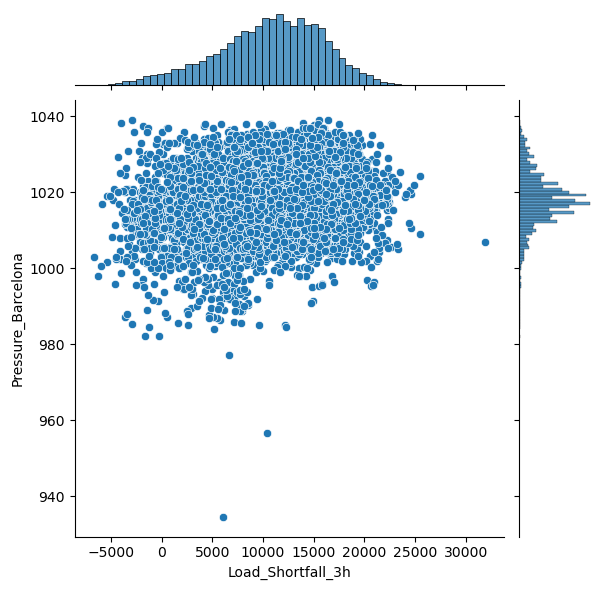

In [36]:
sns.jointplot(x = 'Load_Shortfall_3h', y = 'Pressure_Barcelona', data = df_train)

In [37]:
barcelona = ['Date_Time', 'Month', 'Season','Pressure_Barcelona','Rain_1h_Barcelona','Rain_3h_Barcelona','Temp_max_Barcelona','Temperature_Barcelona','Temp_min_Barcelona','Weather_id_Barcelona','Wind_direction_Barcelona','Wind_speed_Madrid','Load_Shortfall_3h']
bilboa = ['Date_Time', 'Month', 'Season','Clouds_all_Bilboa','Pressure_Bilboa','Rain_1h_Bilboa','Snow_3h_Bilboa','Temp_max_Bilboa','Temperature_Bilboa','Temp_min_Bilboa','Weather_id_Bilboa','Wind_direction_Barcelona','Wind_speed_Bilboa','Load_Shortfall_3h']
madrid = ['Date_Time', 'Month', 'Season','Clouds_all_Madrid','Humidity_Madrid','Pressure_Madrid','Rain_1h_Madrid','Temp_max_Madrid','Temperature_Madrid','Temp_min_Madrid','Weather_id_Madrid','Wind_speed_Madrid','Load_Shortfall_3h']
seville = ['Date_Time', 'Month', 'Season','Clouds_all_Seville','Humidity_Seville','Rain_1h_Seville','Rain_3h_Seville','Temp_max_Seville','Temperature_Seville','Temp_min_Seville','Weather_id_Seville','Wind_speed_Seville','Load_Shortfall_3h']
valencia = ['Date_Time', 'Month', 'Season','Humidity_Valencia','Pressure_Valencia','Snow_3h_Valencia','Temp_max_Valencia','Temperature_Valencia','Temp_min_Valencia','Wind_direction_Valencia','Wind_speed_Valencia','Load_Shortfall_3h']

In [38]:
bar = df_train[barcelona]
bar.head()

,Date_Time,Month,Season,Pressure_Barcelona,Rain_1h_Barcelona,Rain_3h_Barcelona,Temp_max_Barcelona,Temperature_Barcelona,Temp_min_Barcelona,Weather_id_Barcelona,Wind_direction_Barcelona,Wind_speed_Madrid,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,1036.333333,0.0,0.0,281.013000,281.013000,281.013000,800.0,42.666667,0.666667,6715.666667
1,2015-01-01 06:00:00,1,1,1037.333333,0.0,0.0,280.561667,280.561667,280.561667,800.0,139.000000,0.333333,4171.666667
2,2015-01-01 09:00:00,1,1,1038.000000,0.0,0.0,281.583667,281.583667,281.583667,800.0,326.000000,1.000000,4274.666667
3,2015-01-01 12:00:00,1,1,1037.000000,0.0,0.0,283.434104,283.434104,283.434104,800.0,273.000000,1.000000,5075.666667
4,2015-01-01 15:00:00,1,1,1035.000000,0.0,0.0,284.213167,284.213167,284.213167,800.0,260.000000,1.000000,6620.666667


In [39]:
bil = df_train[bilboa]
bil.head()

,Date_Time,Month,Season,Clouds_all_Bilboa,Pressure_Bilboa,Rain_1h_Bilboa,Snow_3h_Bilboa,Temp_max_Bilboa,Temperature_Bilboa,Temp_min_Bilboa,Weather_id_Bilboa,Wind_direction_Barcelona,Wind_speed_Bilboa,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,0.0,1035.000000,0.0,0.0,269.338615,269.338615,269.338615,800.0,42.666667,1.000000,6715.666667
1,2015-01-01 06:00:00,1,1,0.0,1035.666667,0.0,0.0,270.376000,270.376000,270.376000,800.0,139.000000,1.000000,4171.666667
2,2015-01-01 09:00:00,1,1,0.0,1036.000000,0.0,0.0,275.027229,275.027229,275.027229,800.0,326.000000,1.000000,4274.666667
3,2015-01-01 12:00:00,1,1,0.0,1036.000000,0.0,0.0,281.135063,281.135063,281.135063,800.0,273.000000,1.000000,5075.666667
4,2015-01-01 15:00:00,1,1,2.0,1035.333333,0.0,0.0,282.252063,282.252063,282.252063,800.0,260.000000,0.333333,6620.666667


In [40]:
mad = df_train[madrid]
mad.head()

,Date_Time,Month,Season,Clouds_all_Madrid,Humidity_Madrid,Pressure_Madrid,Rain_1h_Madrid,Temp_max_Madrid,Temperature_Madrid,Temp_min_Madrid,Weather_id_Madrid,Wind_speed_Madrid,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,0.0,64.000000,971.333333,0.0,265.938000,265.938000,265.938000,800.0,0.666667,6715.666667
1,2015-01-01 06:00:00,1,1,0.0,64.666667,972.666667,0.0,266.386667,266.386667,266.386667,800.0,0.333333,4171.666667
2,2015-01-01 09:00:00,1,1,0.0,64.333333,974.000000,0.0,272.708667,272.708667,272.708667,800.0,1.000000,4274.666667
3,2015-01-01 12:00:00,1,1,0.0,56.333333,994.666667,0.0,281.895219,281.895219,281.895219,800.0,1.000000,5075.666667
4,2015-01-01 15:00:00,1,1,0.0,57.000000,1035.333333,0.0,280.678437,280.678437,280.678437,800.0,1.000000,6620.666667


In [41]:
sev = df_train[seville]
sev.head()

,Date_Time,Month,Season,Clouds_all_Seville,Humidity_Seville,Rain_1h_Seville,Rain_3h_Seville,Temp_max_Seville,Temperature_Seville,Temp_min_Seville,Weather_id_Seville,Wind_speed_Seville,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,0.0,74.333333,0.0,0.0,274.254667,274.254667,274.254667,800.0,3.333333,6715.666667
1,2015-01-01 06:00:00,1,1,0.0,78.333333,0.0,0.0,274.945000,274.945000,274.945000,800.0,3.333333,4171.666667
2,2015-01-01 09:00:00,1,1,0.0,71.333333,0.0,0.0,278.792000,278.792000,278.792000,800.0,2.666667,4274.666667
3,2015-01-01 12:00:00,1,1,0.0,65.333333,0.0,0.0,285.394000,285.394000,285.394000,800.0,4.000000,5075.666667
4,2015-01-01 15:00:00,1,1,0.0,59.000000,0.0,0.0,285.513719,285.513719,285.513719,800.0,3.000000,6620.666667


In [42]:
val = df_train[valencia]
val.head()

,Date_Time,Month,Season,Humidity_Valencia,Pressure_Valencia,Snow_3h_Valencia,Temp_max_Valencia,Temperature_Valencia,Temp_min_Valencia,Wind_direction_Valencia,Wind_speed_Valencia,Load_Shortfall_3h
0,2015-01-01 03:00:00,1,1,75.666667,1002.666667,0.0,269.888000,269.888000,269.888000,level_5,0.666667,6715.666667
1,2015-01-01 06:00:00,1,1,71.000000,1004.333333,0.0,271.728333,271.728333,271.728333,level_10,1.666667,4171.666667
2,2015-01-01 09:00:00,1,1,65.666667,1005.333333,0.0,278.008667,278.008667,278.008667,level_9,1.000000,4274.666667
3,2015-01-01 12:00:00,1,1,54.000000,1009.000000,0.0,284.899552,284.899552,284.899552,level_8,1.000000,5075.666667
4,2015-01-01 15:00:00,1,1,58.333333,1012.051407,0.0,283.015115,283.015115,283.015115,level_7,1.000000,6620.666667


In [43]:
bar.corr()

,Month,Season,Pressure_Barcelona,Rain_1h_Barcelona,Rain_3h_Barcelona,Temp_max_Barcelona,Temperature_Barcelona,Temp_min_Barcelona,Weather_id_Barcelona,Wind_direction_Barcelona,Wind_speed_Madrid,Load_Shortfall_3h
Month,1.000000,0.574388,0.193950,-0.029252,-0.056726,0.230539,0.203184,0.159629,0.025352,0.021463,-0.237445,0.199048
Season,0.574388,1.000000,-0.096921,0.039031,-0.039804,0.543246,0.527081,0.479905,-0.024873,-0.081097,-0.149807,0.176688
Pressure_Barcelona,0.193950,-0.096921,1.000000,-0.106995,0.035348,-0.174191,-0.163835,-0.133498,0.179759,0.077281,-0.432118,0.149881
Rain_1h_Barcelona,-0.029252,0.039031,-0.106995,1.000000,-0.020084,0.083288,0.060384,0.023582,-0.525751,-0.037854,0.062758,-0.056633
Rain_3h_Barcelona,-0.056726,-0.039804,0.035348,-0.020084,1.000000,-0.051365,-0.042970,-0.029398,0.026554,-0.011875,-0.014644,-0.024720
Temp_max_Barcelona,0.230539,0.543246,-0.174191,0.083288,-0.051365,1.000000,0.974480,0.885911,0.018332,-0.151302,0.061854,0.164734
Temperature_Barcelona,0.203184,0.527081,-0.163835,0.060384,-0.042970,0.974480,1.000000,0.964089,0.029239,-0.189016,0.080133,0.182673
Temp_min_Barcelona,0.159629,0.479905,-0.133498,0.023582,-0.029398,0.885911,0.964089,1.000000,0.046167,-0.226583,0.089992,0.195984
Weather_id_Barcelona,0.025352,-0.024873,0.179759,-0.525751,0.026554,0.018332,0.029239,0.046167,1.000000,0.151534,-0.099582,0.063868
Wind_direction_Barcelona,0.021463,-0.081097,0.077281,-0.037854,-0.011875,-0.151302,-0.189016,-0.226583,0.151534,1.000000,-0.095380,-0.116133


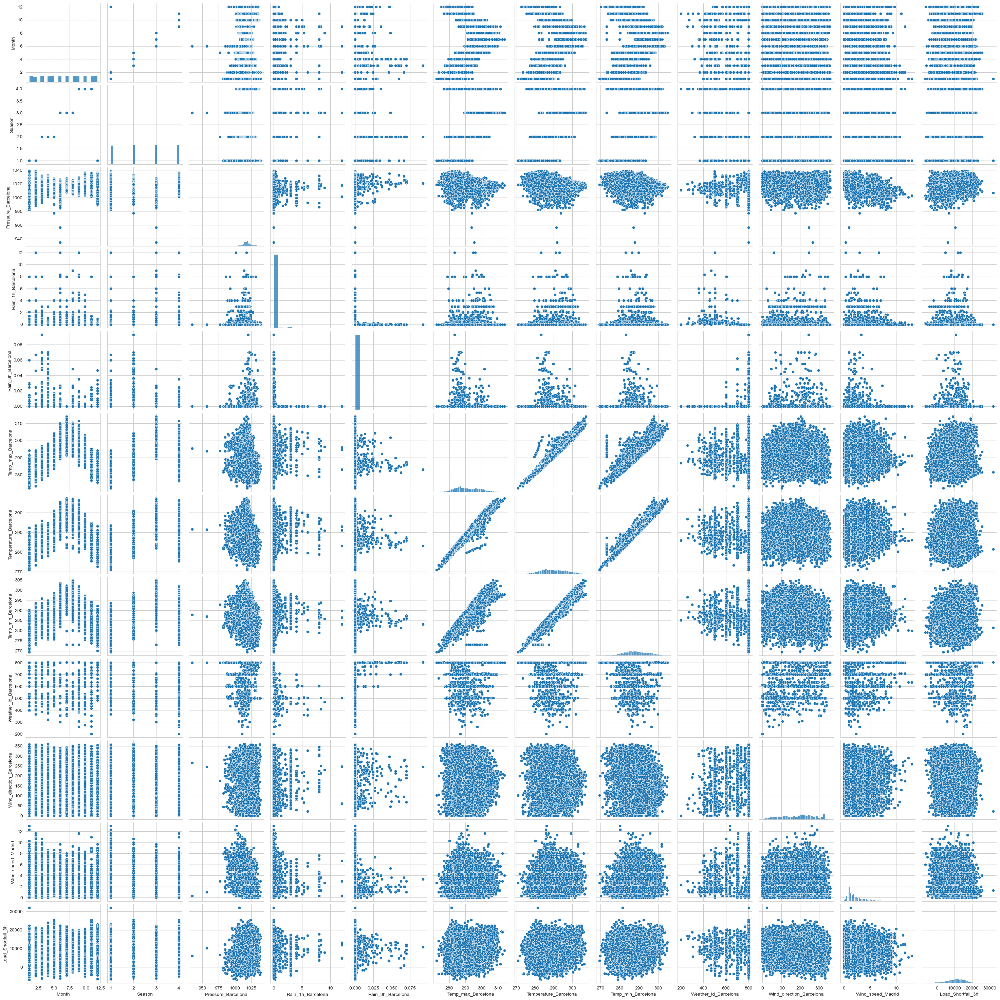

In [44]:
sns.set_style("whitegrid");
sns.pairplot(bar);
plt.show();

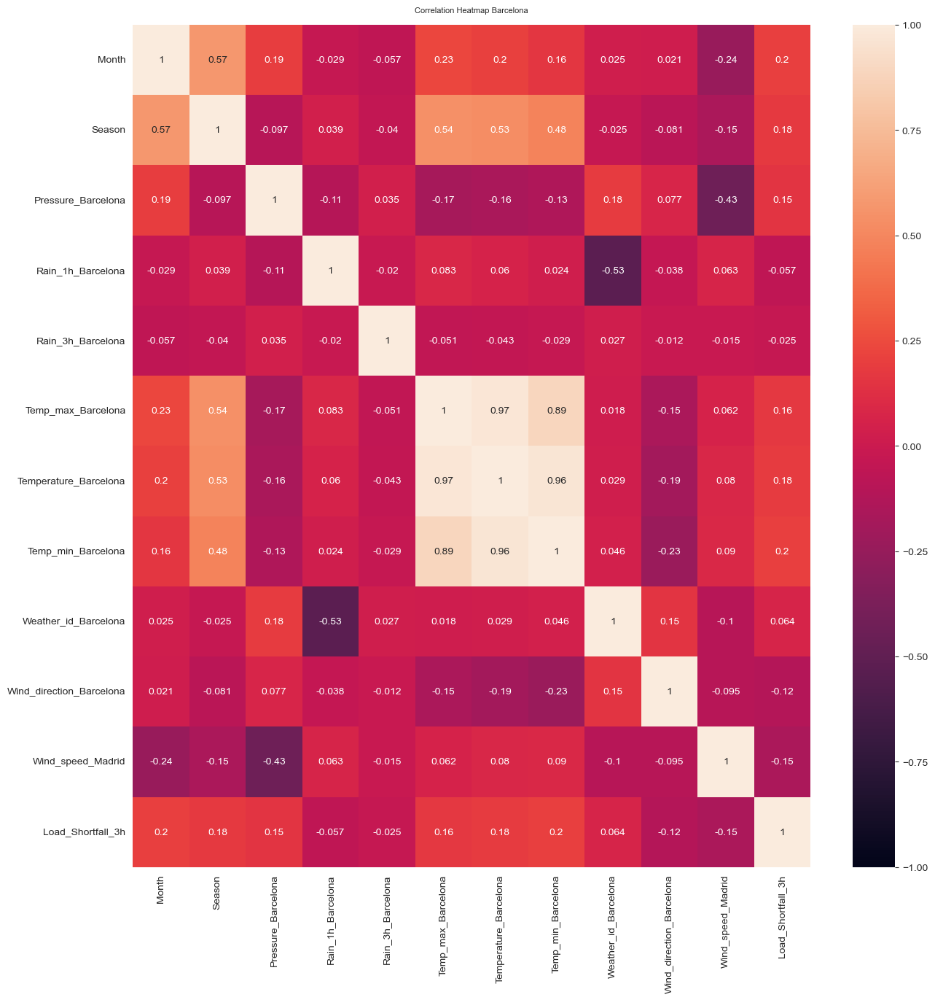

In [45]:
plt.figure(figsize=(15,15))
heatmap = sns.heatmap(bar.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap Barcelona', fontdict={'fontsize':8}, pad=12);

In [46]:
bil.corr()

,Month,Season,Clouds_all_Bilboa,Pressure_Bilboa,Rain_1h_Bilboa,Snow_3h_Bilboa,Temp_max_Bilboa,Temperature_Bilboa,Temp_min_Bilboa,Weather_id_Bilboa,Wind_direction_Barcelona,Wind_speed_Bilboa,Load_Shortfall_3h
Month,1.000000,0.574388,-0.117452,0.010533,-0.188274,-0.075644,0.277963,0.239443,0.195889,0.141738,0.021463,-0.086698,0.199048
Season,0.574388,1.000000,-0.037711,-0.214626,-0.144427,-0.074332,0.451982,0.459051,0.450996,0.108194,-0.081097,-0.141810,0.176688
Clouds_all_Bilboa,-0.117452,-0.037711,1.000000,0.000377,0.370733,0.080180,-0.158014,-0.114118,-0.067731,-0.536205,-0.065120,0.031915,-0.127293
Pressure_Bilboa,0.010533,-0.214626,0.000377,1.000000,-0.054814,-0.023428,-0.221529,-0.250325,-0.267415,0.060315,0.123565,-0.122915,0.039052
Rain_1h_Bilboa,-0.188274,-0.144427,0.370733,-0.054814,1.000000,0.096730,-0.219871,-0.182494,-0.141269,-0.604616,-0.030723,0.085398,-0.152510
Snow_3h_Bilboa,-0.075644,-0.074332,0.080180,-0.023428,0.096730,1.000000,-0.105006,-0.096477,-0.086115,-0.107220,-0.023039,-0.001642,-0.031721
Temp_max_Bilboa,0.277963,0.451982,-0.158014,-0.221529,-0.219871,-0.105006,1.000000,0.981624,0.932219,0.235183,-0.147388,0.177123,0.180934
Temperature_Bilboa,0.239443,0.459051,-0.114118,-0.250325,-0.182494,-0.096477,0.981624,1.000000,0.982936,0.190635,-0.164656,0.142435,0.176411
Temp_min_Bilboa,0.195889,0.450996,-0.067731,-0.267415,-0.141269,-0.086115,0.932219,0.982936,1.000000,0.140580,-0.182302,0.107302,0.172920
Weather_id_Bilboa,0.141738,0.108194,-0.536205,0.060315,-0.604616,-0.107220,0.235183,0.190635,0.140580,1.000000,0.049678,-0.031661,0.145875


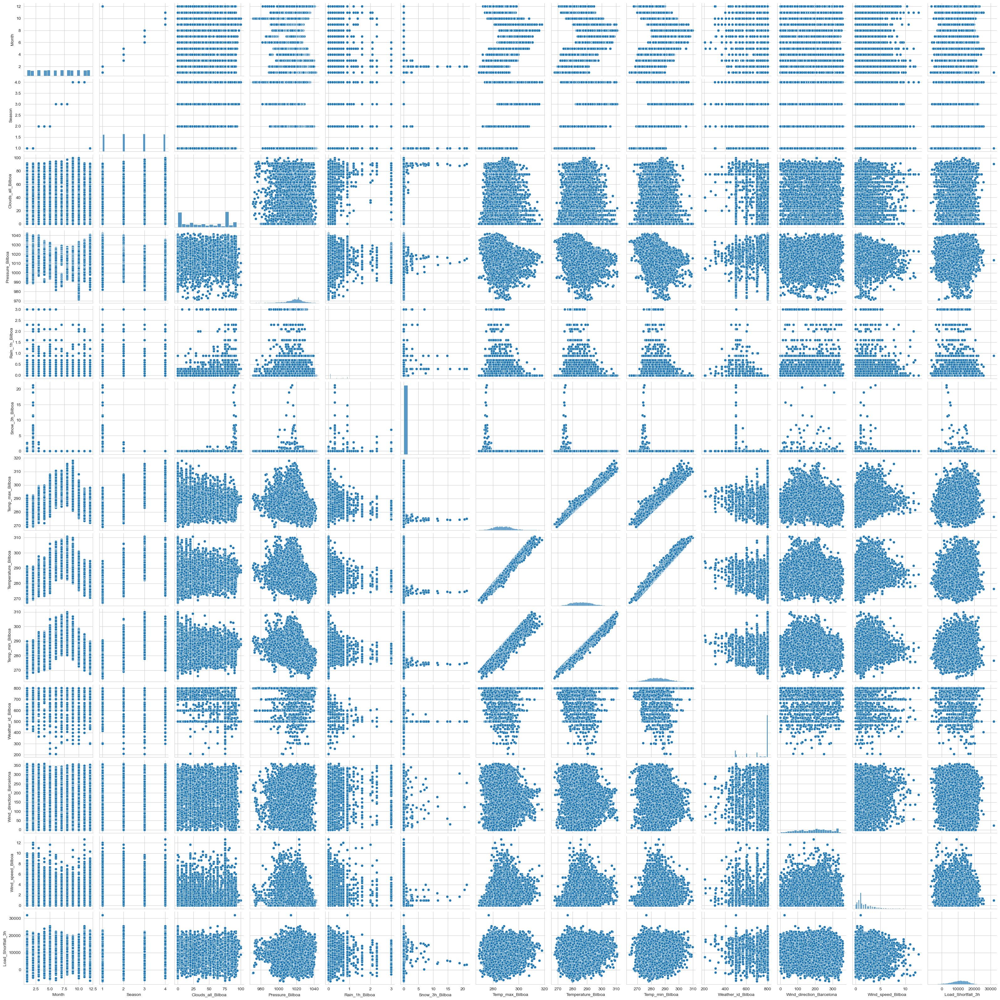

In [47]:
sns.set_style("whitegrid");
sns.pairplot(bil);
plt.show();

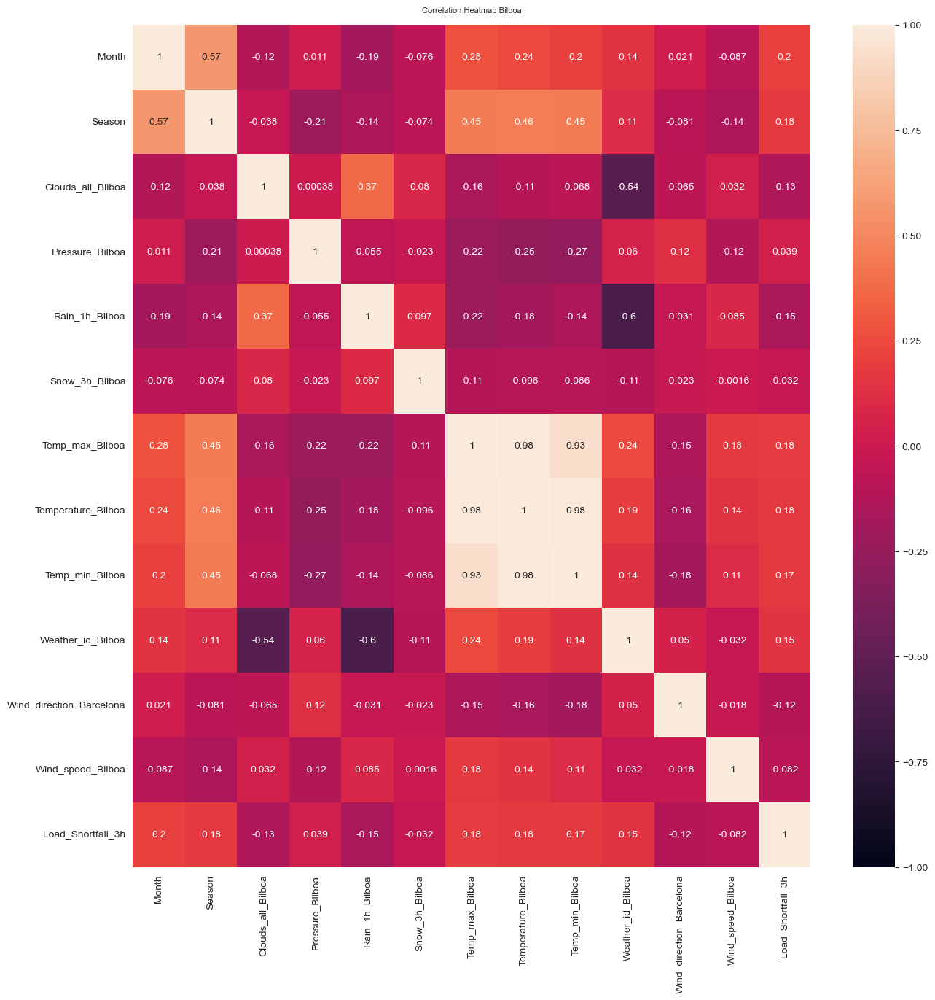

In [48]:
plt.figure(figsize=(15,15))
heatmap = sns.heatmap(bil.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap Bilboa', fontdict={'fontsize':8}, pad=12);

In [49]:
mad.corr()

,Month,Season,Clouds_all_Madrid,Humidity_Madrid,Pressure_Madrid,Rain_1h_Madrid,Temp_max_Madrid,Temperature_Madrid,Temp_min_Madrid,Weather_id_Madrid,Wind_speed_Madrid,Load_Shortfall_3h
Month,1.000000,0.574388,-0.118792,-0.076567,0.269350,-0.070592,0.191223,0.182860,0.157368,0.068856,-0.237445,0.199048
Season,0.574388,1.000000,-0.217232,-0.344818,0.094014,-0.044203,0.472483,0.467024,0.426441,0.082069,-0.149807,0.176688
Clouds_all_Madrid,-0.118792,-0.217232,1.000000,0.484293,-0.190070,0.402147,-0.279732,-0.262908,-0.245475,-0.533331,0.230126,-0.081623
Humidity_Madrid,-0.076567,-0.344818,0.484293,1.000000,-0.121737,0.250614,-0.803260,-0.802605,-0.759633,-0.341407,-0.137092,-0.150536
Pressure_Madrid,0.269350,0.094014,-0.190070,-0.121737,1.000000,-0.081161,0.092253,0.054819,0.014089,0.098011,-0.136672,0.092638
Rain_1h_Madrid,-0.070592,-0.044203,0.402147,0.250614,-0.081161,1.000000,-0.116052,-0.105667,-0.094601,-0.718816,0.150446,-0.027159
Temp_max_Madrid,0.191223,0.472483,-0.279732,-0.803260,0.092253,-0.116052,1.000000,0.988871,0.939147,0.149340,0.091464,0.182548
Temperature_Madrid,0.182860,0.467024,-0.262908,-0.802605,0.054819,-0.105667,0.988871,1.000000,0.973641,0.136829,0.109572,0.186036
Temp_min_Madrid,0.157368,0.426441,-0.245475,-0.759633,0.014089,-0.094601,0.939147,0.973641,1.000000,0.123498,0.098138,0.174744
Weather_id_Madrid,0.068856,0.082069,-0.533331,-0.341407,0.098011,-0.718816,0.149340,0.136829,0.123498,1.000000,-0.169358,0.030868


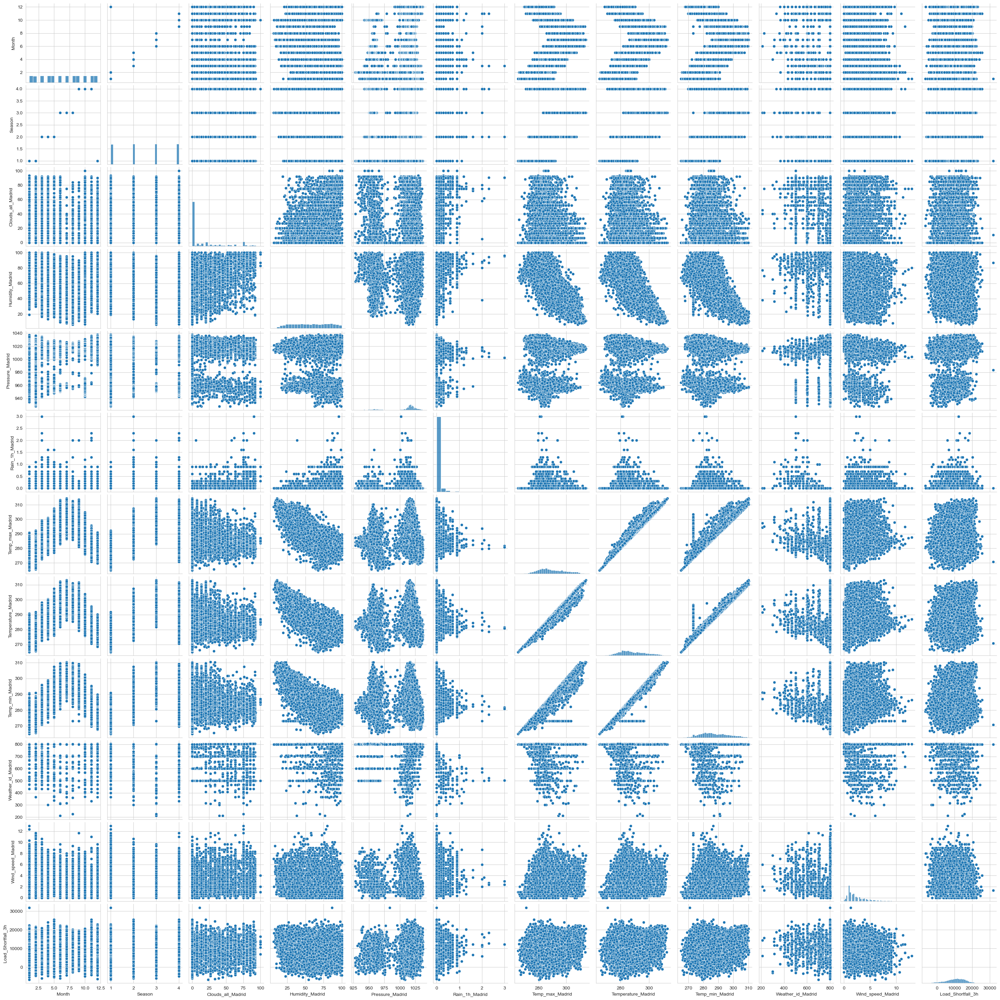

In [50]:
sns.set_style("whitegrid");
sns.pairplot(mad);
plt.show();

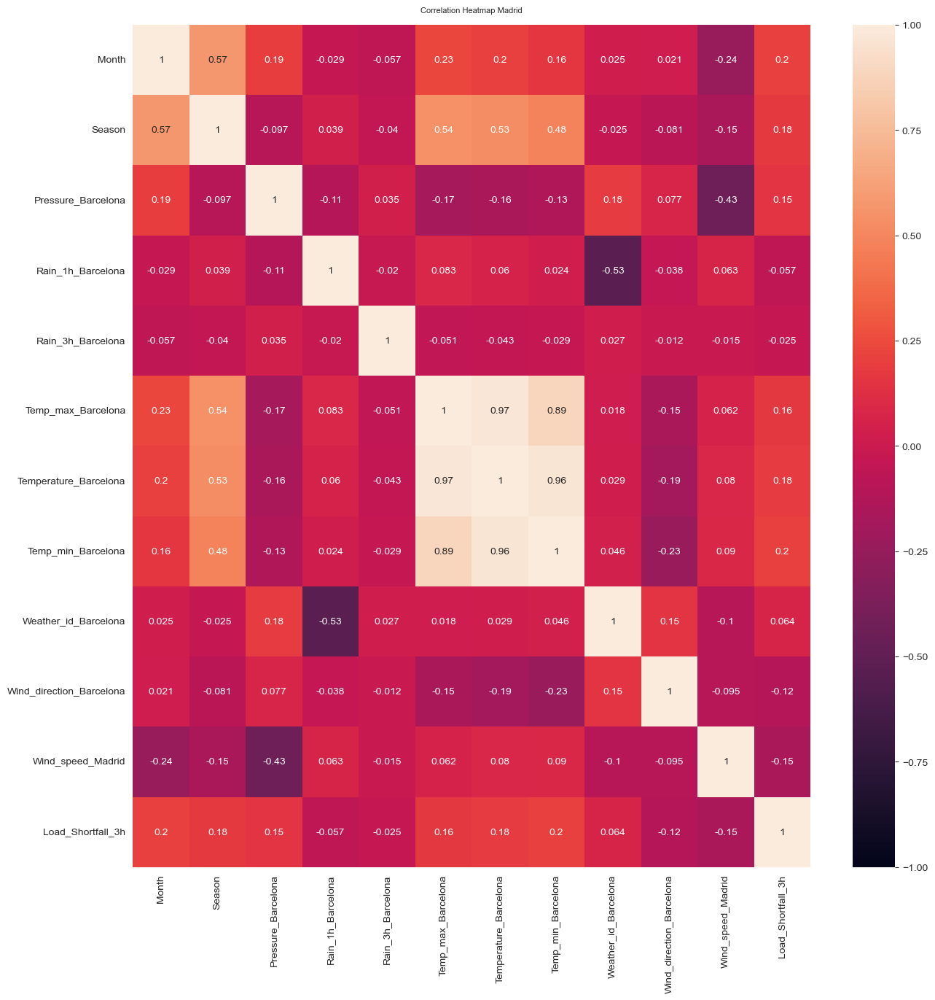

In [51]:
plt.figure(figsize=(15,15))
heatmap = sns.heatmap(bar.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap Madrid', fontdict={'fontsize':8}, pad=12);

In [52]:
sev.corr()

,Month,Season,Clouds_all_Seville,Humidity_Seville,Rain_1h_Seville,Rain_3h_Seville,Temp_max_Seville,Temperature_Seville,Temp_min_Seville,Weather_id_Seville,Wind_speed_Seville,Load_Shortfall_3h
Month,1.000000,0.574388,-0.170345,-0.111622,-0.072631,-0.055265,0.193143,0.213623,0.205000,0.100786,-0.122624,0.199048
Season,0.574388,1.000000,-0.184436,-0.292314,-0.059126,-0.029696,0.419200,0.482373,0.477059,0.097999,-0.090860,0.176688
Clouds_all_Seville,-0.170345,-0.184436,1.000000,0.399436,0.408001,0.087240,-0.181783,-0.208859,-0.200453,-0.537924,0.144119,-0.091804
Humidity_Seville,-0.111622,-0.292314,0.399436,1.000000,0.227476,0.034343,-0.566426,-0.743126,-0.784850,-0.328265,-0.202449,-0.167290
Rain_1h_Seville,-0.072631,-0.059126,0.408001,0.227476,1.000000,-0.007996,-0.094417,-0.113766,-0.113038,-0.693443,0.125560,-0.031572
Rain_3h_Seville,-0.055265,-0.029696,0.087240,0.034343,-0.007996,1.000000,-0.067920,-0.051013,-0.032983,0.009732,0.001149,-0.032945
Temp_max_Seville,0.193143,0.419200,-0.181783,-0.566426,-0.094417,-0.067920,1.000000,0.907261,0.743801,0.117190,0.096339,0.109834
Temperature_Seville,0.213623,0.482373,-0.208859,-0.743126,-0.113766,-0.051013,0.907261,1.000000,0.955160,0.166098,0.139573,0.159343
Temp_min_Seville,0.205000,0.477059,-0.200453,-0.784850,-0.113038,-0.032983,0.743801,0.955160,1.000000,0.180721,0.154254,0.174718
Weather_id_Seville,0.100786,0.097999,-0.537924,-0.328265,-0.693443,0.009732,0.117190,0.166098,0.180721,1.000000,-0.143958,0.061104


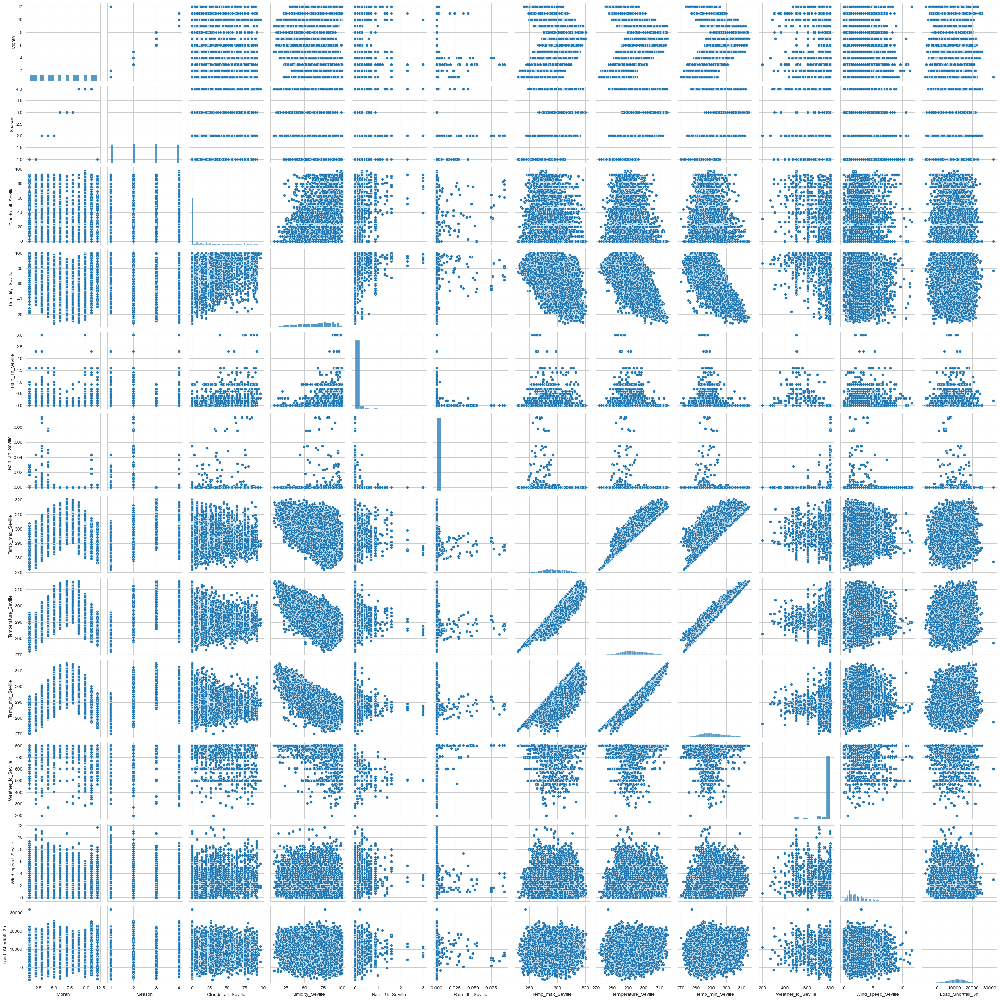

In [53]:
sns.set_style("whitegrid");
sns.pairplot(sev);
plt.show();

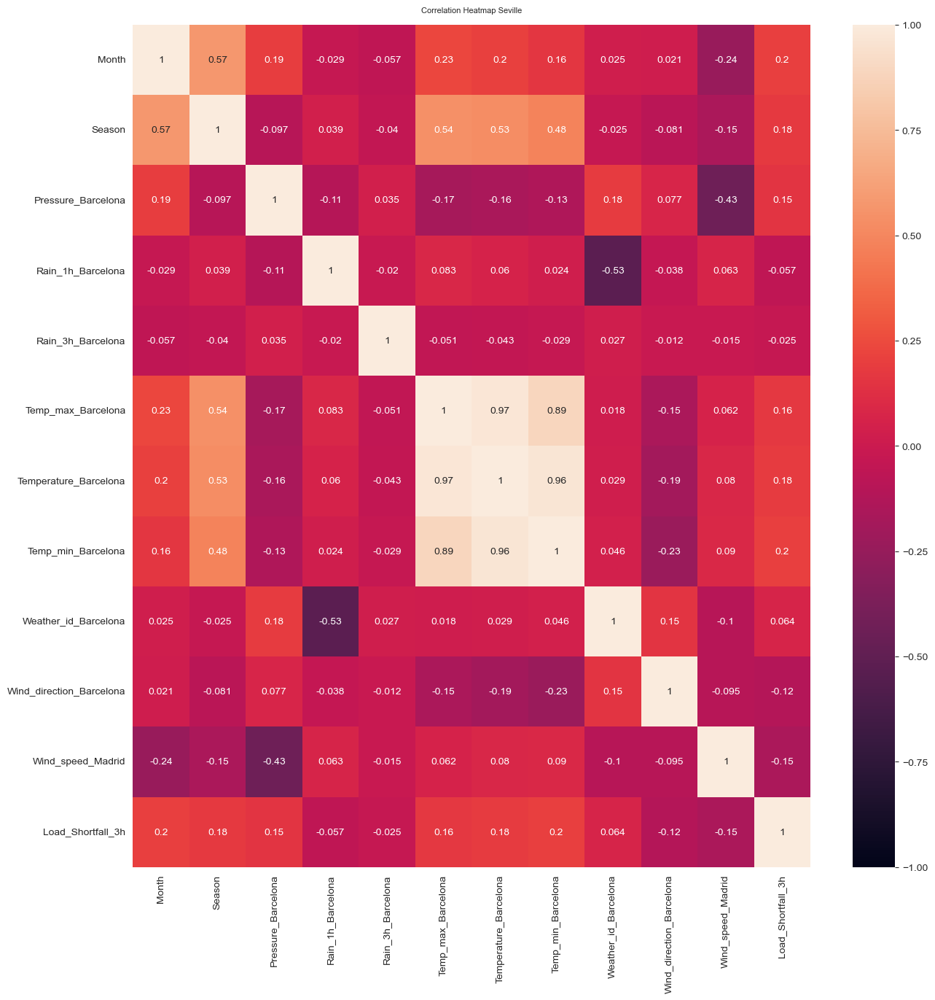

In [54]:
plt.figure(figsize=(15,15))
heatmap = sns.heatmap(bar.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap Seville', fontdict={'fontsize':8}, pad=12);

In [55]:
val.corr()

,Month,Season,Humidity_Valencia,Pressure_Valencia,Snow_3h_Valencia,Temp_max_Valencia,Temperature_Valencia,Temp_min_Valencia,Wind_speed_Valencia,Load_Shortfall_3h
Month,1.000000,0.574388,0.162713,0.053704,-0.022720,0.210184,0.216464,0.220501,-0.237156,0.199048
Season,0.574388,1.000000,0.042495,0.050463,-0.023356,0.492845,0.491729,0.479553,-0.221606,0.176688
Humidity_Valencia,0.162713,0.042495,1.000000,-0.018384,-0.019085,-0.399380,-0.413654,-0.413537,-0.413017,0.043140
Pressure_Valencia,0.053704,0.050463,-0.018384,1.000000,-0.027014,0.098061,0.074464,0.047704,-0.038234,0.076012
Snow_3h_Valencia,-0.022720,-0.023356,-0.019085,-0.027014,1.000000,-0.027693,-0.027452,-0.026649,0.058629,-0.021633
Temp_max_Valencia,0.210184,0.492845,-0.399380,0.098061,-0.027693,1.000000,0.987533,0.949377,0.065815,0.144270
Temperature_Valencia,0.216464,0.491729,-0.413654,0.074464,-0.027452,0.987533,1.000000,0.985479,0.072366,0.173225
Temp_min_Valencia,0.220501,0.479553,-0.413537,0.047704,-0.026649,0.949377,0.985479,1.000000,0.075533,0.201863
Wind_speed_Valencia,-0.237156,-0.221606,-0.413017,-0.038234,0.058629,0.065815,0.072366,0.075533,1.000000,-0.142791
Load_Shortfall_3h,0.199048,0.176688,0.043140,0.076012,-0.021633,0.144270,0.173225,0.201863,-0.142791,1.000000


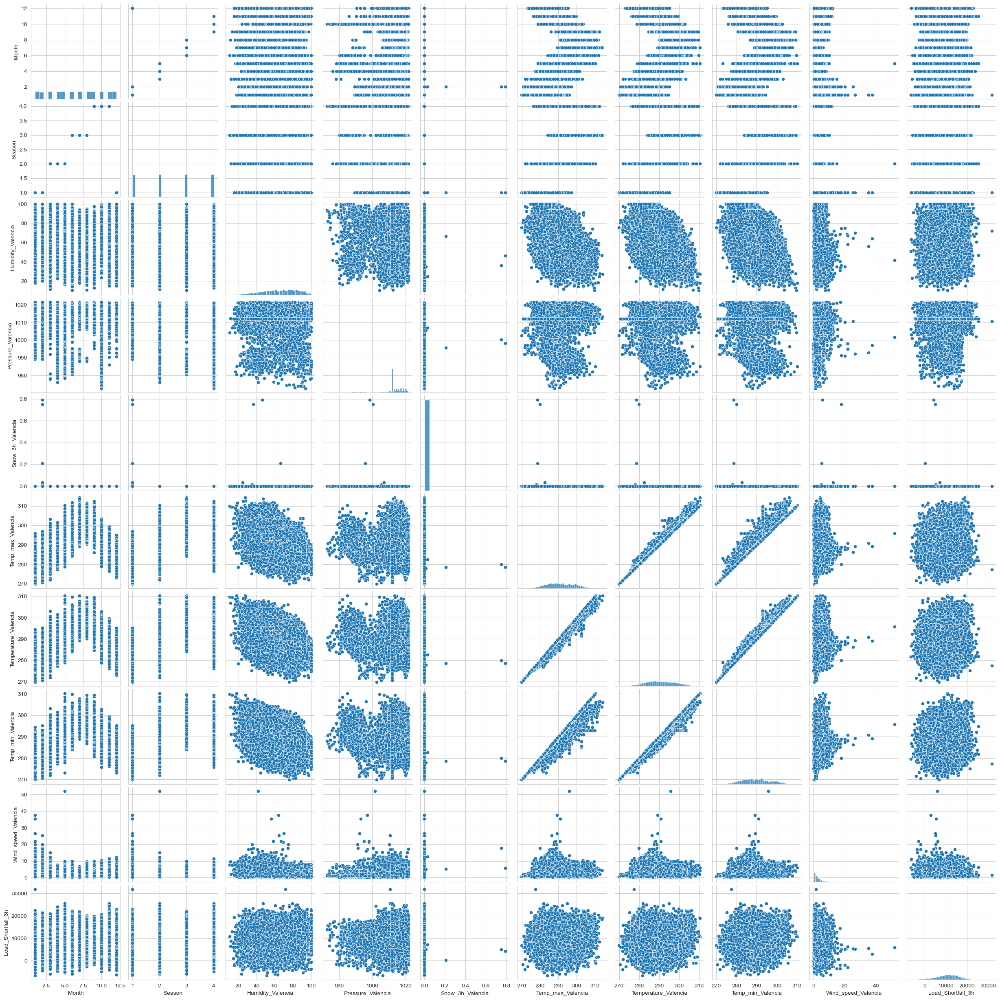

In [56]:
sns.set_style("whitegrid");
sns.pairplot(val);
plt.show();

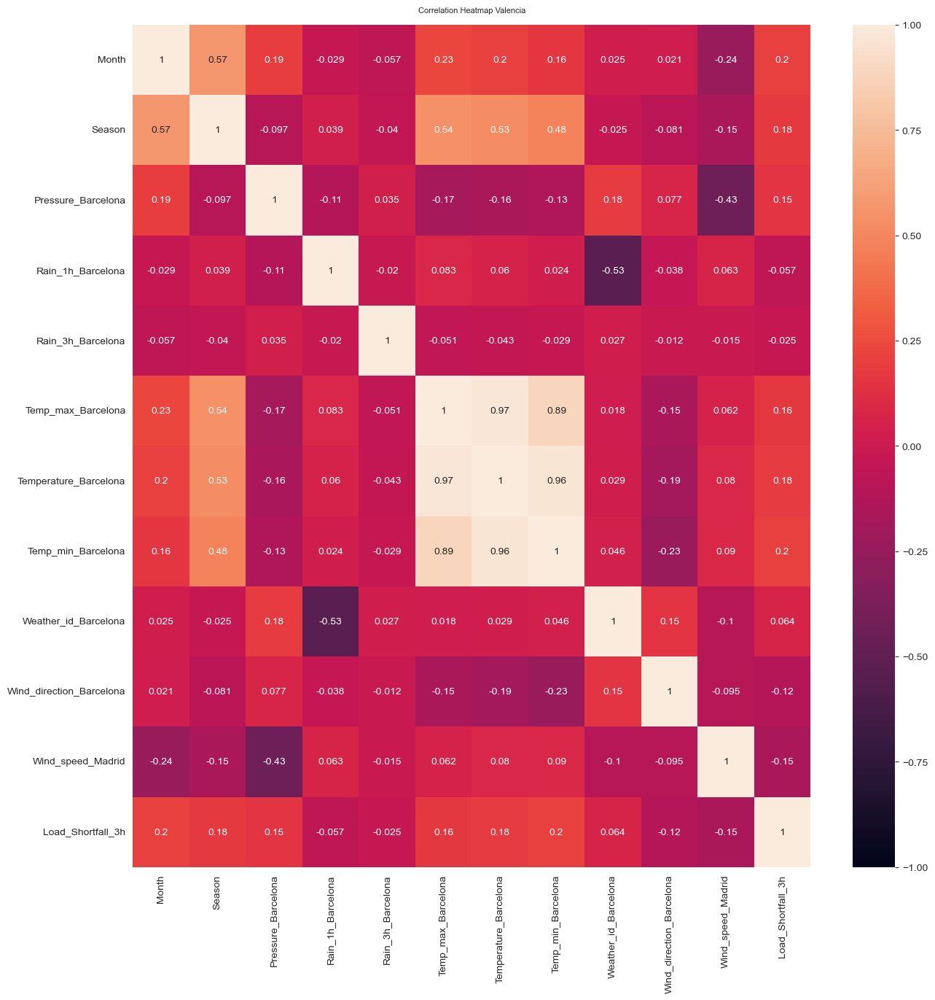

In [57]:
plt.figure(figsize=(15,15))
heatmap = sns.heatmap(bar.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap Valencia', fontdict={'fontsize':8}, pad=12);

In [58]:
df_train['Load_Shortfall_3h'].max()

31904.0

In [59]:
df_train['Load_Shortfall_3h'].min()

-6618.0

In [60]:
df_train['Load_Shortfall_3h'].groupby(pd.cut(df_train['Load_Shortfall_3h'], np.arange(-9000,36000,3000))).count()

Load_Shortfall_3h
(-9000, -6000]       2
(-6000, -3000]      54
(-3000, 0]         261
(0, 3000]          472
(3000, 6000]       816
(6000, 9000]      1417
(9000, 12000]     1975
(12000, 15000]    1901
(15000, 18000]    1330
(18000, 21000]     449
(21000, 24000]      77
(24000, 27000]       8
(27000, 30000]       0
(30000, 33000]       1
Name: Load_Shortfall_3h, dtype: int64

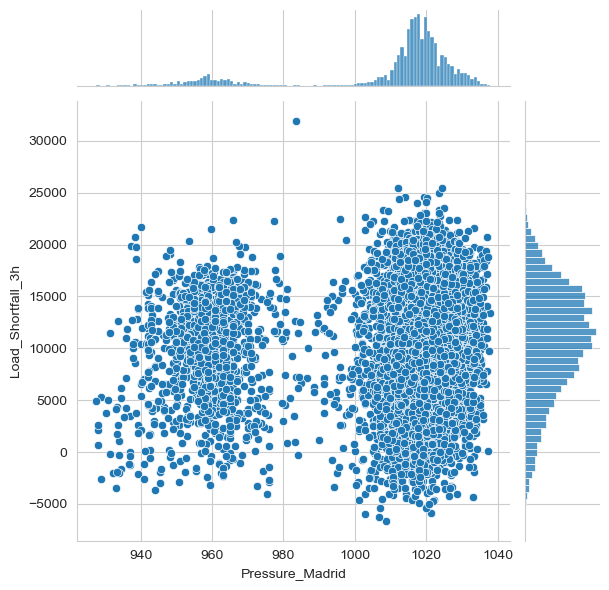

In [61]:
sns.jointplot(x = 'Pressure_Madrid', y = 'Load_Shortfall_3h', data = df_train)

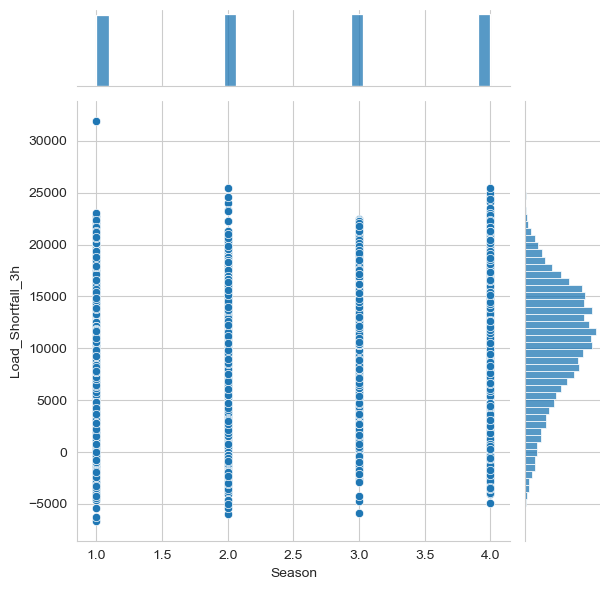

In [62]:
sns.jointplot(x = 'Season', y = 'Load_Shortfall_3h', data = df_train)

In [63]:
cat1 = df_train.loc[df_train['Load_Shortfall_3h'] > 27000]
cat1

,Date_Time,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_direction_Valencia,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia,Load_Shortfall_3h
148,2015-01-19 21:00:00,1,1,90.666667,10.666667,0.0,86.666667,77.333333,72.0,1007.0,1013.666667,983.666667,17,1010.666667,0.0,0.9,0.0,0.2,0.0,0.0,0.0,0.0,281.426,276.486604,270.831885,277.363833,277.387104,281.426,276.486604,270.831885,277.363833,277.387104,281.426,276.486604,270.831885,277.363833,277.387104,804.0,501.0,800.666667,600.0,23.333333,272.666667,level_8,3.0,1.0,1.333333,3.0,1.666667,31904.0


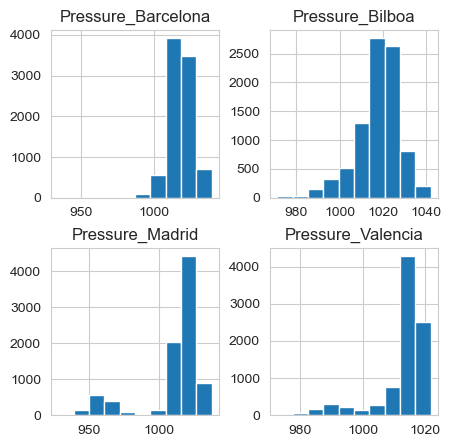

In [64]:
pressure = ['Pressure_Barcelona', 'Pressure_Bilboa', 'Pressure_Madrid', 'Pressure_Valencia']
df_train[pressure].hist(figsize=(5,5));

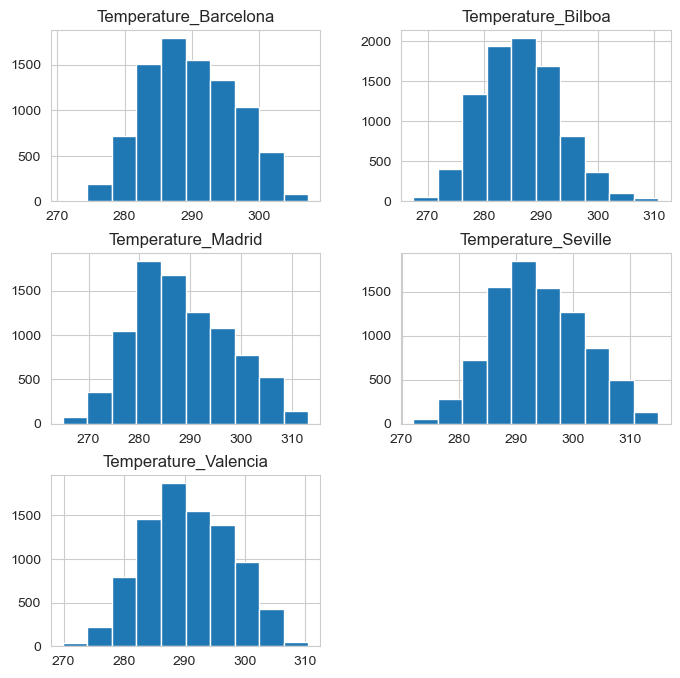

In [65]:
temperature = ['Temperature_Barcelona', 'Temperature_Bilboa', 'Temperature_Madrid', 'Temperature_Seville','Temperature_Valencia']
df_train[temperature].hist(figsize=(8,8));

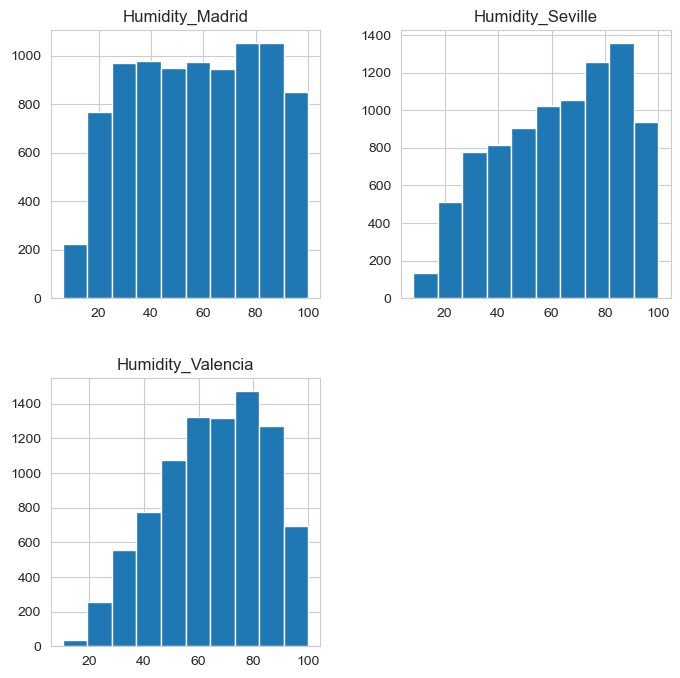

In [66]:
humidity = ['Humidity_Madrid', 'Humidity_Seville','Humidity_Valencia']
df_train[humidity].hist(figsize=(8,8));

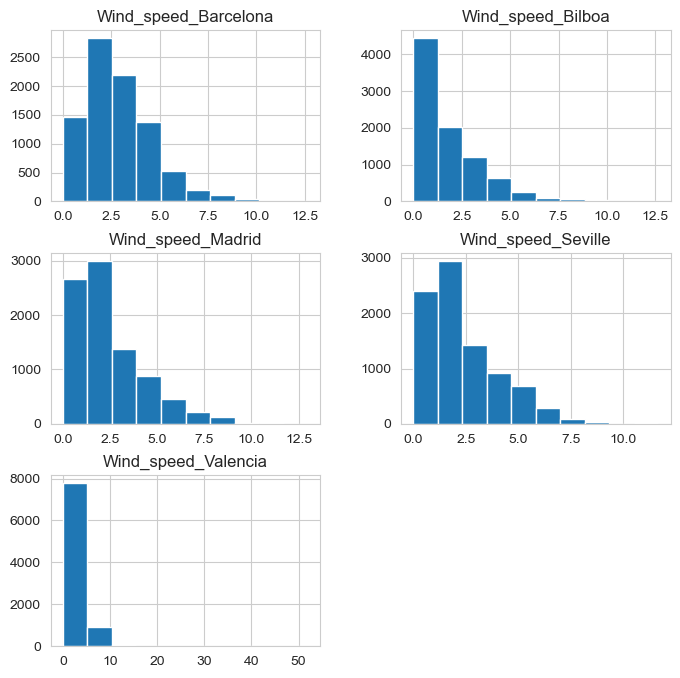

In [67]:
wind_speed = ['Wind_speed_Barcelona', 'Wind_speed_Bilboa', 'Wind_speed_Madrid', 'Wind_speed_Seville','Wind_speed_Valencia']
df_train[wind_speed].hist(figsize=(8,8));

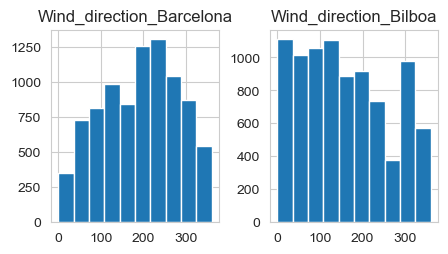

In [68]:
wind_dir = ['Wind_direction_Barcelona', 'Wind_direction_Bilboa']
df_train[wind_dir].hist(figsize=(5,2.5));

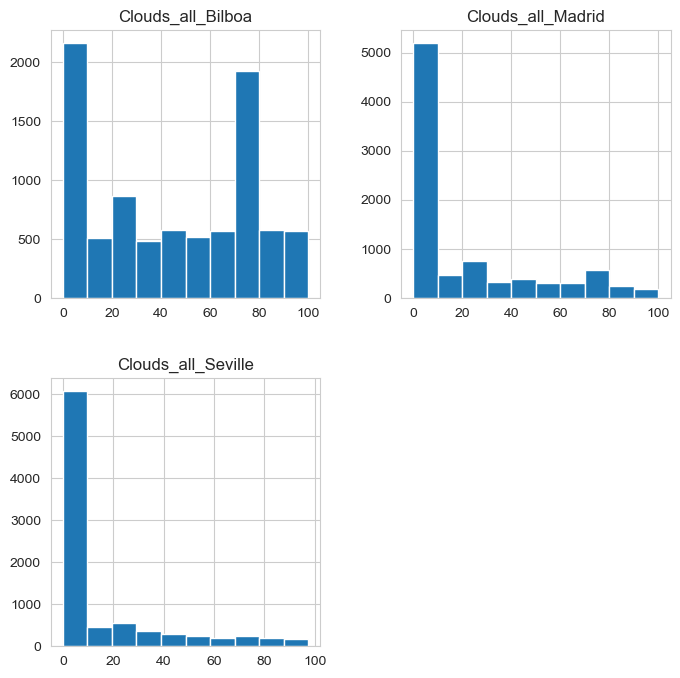

In [69]:
cloud = ['Clouds_all_Bilboa','Clouds_all_Madrid','Clouds_all_Seville']
df_train[cloud].hist(figsize=(8,8));

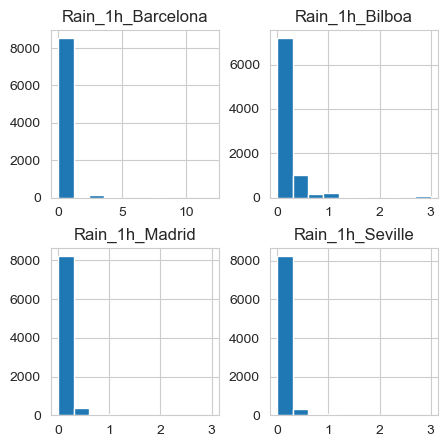

In [70]:
rain1 = ['Rain_1h_Barcelona','Rain_1h_Bilboa','Rain_1h_Madrid','Rain_1h_Seville']
df_train[rain1].hist(figsize=(5,5));

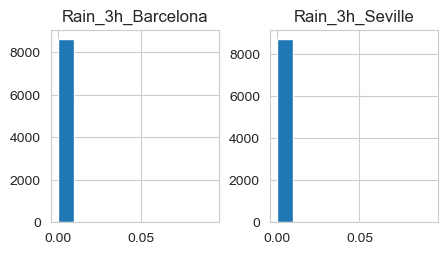

In [71]:
rain3 = ['Rain_3h_Barcelona','Rain_3h_Seville']
df_train[rain3].hist(figsize=(5,2.5));

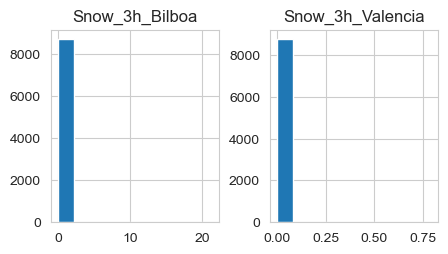

In [72]:
snow3 = ['Snow_3h_Bilboa','Snow_3h_Valencia']
df_train[snow3].hist(figsize=(5,2.5));

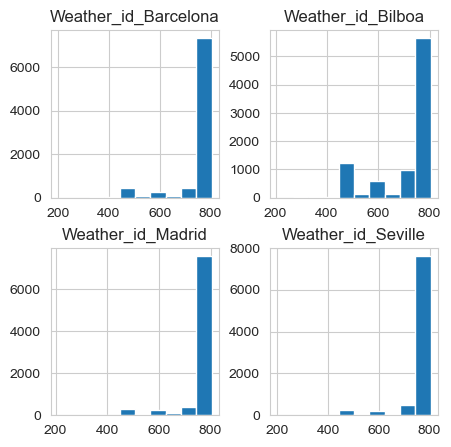

In [73]:
id = ['Weather_id_Barcelona','Weather_id_Bilboa','Weather_id_Madrid','Weather_id_Seville']
df_train[id].hist(figsize=(5,5));

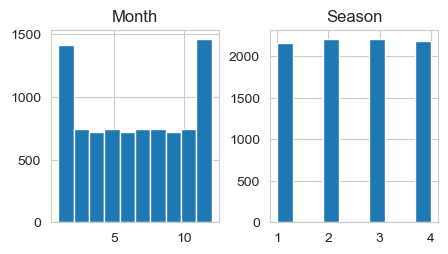

In [74]:
season = ['Month','Season']
df_train[season].hist(figsize=(5,2.5));

In [75]:
cat2 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 24000) & (df_train['Load_Shortfall_3h'] < 27000)]
cat2

,Date_Time,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_direction_Valencia,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia,Load_Shortfall_3h
6898,2017-05-12 21:00:00,5,2,63.333333,20.000000,26.666667,77.000000,78.666667,47.000000,1009.000000,1008.333333,1012.000000,6,1010.666667,0.0,0.4,0.1,0.0,0.0,0.0,0.0,0.0,293.483333,288.483333,288.150000,302.483333,294.816667,292.483333,286.150000,286.483333,291.150000,294.816667,292.983333,287.200000,287.393333,295.620000,294.816667,800.333333,404.000000,707.333333,801.333333,226.666667,210.000000,level_9,2.333333,1.000000,4.000000,5.666667,6.333333,25490.333333
6899,2017-05-13 00:00:00,5,2,51.666667,33.333333,26.666667,81.666667,89.666667,60.666667,1010.666667,1011.000000,1014.000000,10,1013.000000,0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,291.483333,287.483333,286.483333,303.483333,292.150000,290.150000,284.483333,285.483333,288.816667,292.150000,290.800000,285.846667,285.960000,294.723333,292.150000,800.000000,701.333333,801.666667,801.333333,160.000000,146.000000,level_8,0.666667,1.000000,0.333333,3.333333,3.333333,24611.000000
8394,2017-11-15 21:00:00,11,4,0.000000,0.000000,0.000000,55.333333,66.333333,75.666667,1019.666667,1021.000000,1019.333333,14,1019.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,281.483333,278.483333,279.816667,286.150000,282.150000,278.483333,275.816667,278.483333,285.150000,282.150000,279.983333,277.006667,279.200000,285.543333,282.150000,800.000000,800.000000,800.000000,800.000000,283.333333,76.666667,level_10,1.333333,0.333333,1.000000,2.333333,2.000000,24582.333333
8402,2017-11-16 21:00:00,11,4,0.000000,0.000000,0.000000,71.666667,71.000000,83.000000,1020.666667,1023.333333,1020.333333,15,1020.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,283.483333,280.816667,282.816667,285.483333,282.483333,281.150000,276.483333,280.816667,283.816667,282.483333,282.316667,278.416667,281.630000,284.473333,282.483333,800.000000,800.000000,800.000000,800.000000,103.333333,66.666667,level_1,0.333333,1.000000,1.000000,1.333333,0.666667,24492.666667
8434,2017-11-20 21:00:00,11,4,0.000000,0.000000,0.000000,62.333333,56.666667,85.000000,1022.000000,1022.000000,1023.666667,17,1012.051407,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,284.150000,281.483333,281.483333,287.150000,283.816667,281.483333,275.150000,279.816667,285.816667,283.816667,282.816667,277.976667,280.720000,286.413333,283.816667,800.000000,800.000000,800.000000,800.000000,253.000000,96.666667,level_7,4.000000,1.333333,2.000000,0.666667,0.666667,24919.333333
8442,2017-11-21 21:00:00,11,4,0.000000,0.000000,0.000000,59.666667,59.333333,75.666667,1019.666667,1017.000000,1020.000000,15,1020.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,283.816667,282.150000,281.483333,284.816667,281.816667,280.483333,275.150000,278.816667,284.150000,281.816667,282.150000,278.356667,279.873333,284.410000,281.816667,800.000000,800.000000,800.000000,800.000000,276.666667,73.333333,level_6,1.000000,1.000000,1.000000,0.666667,1.000000,24091.000000
8490,2017-11-27 21:00:00,11,4,0.000000,0.000000,0.000000,64.333333,69.666667,79.666667,1024.333333,1024.000000,1024.333333,20,1012.051407,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,281.483333,278.816667,276.483333,287.150000,281.816667,279.483333,273.816667,275.816667,284.816667,281.816667,280.543333,276.163333,276.043333,285.7

In [76]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat2.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T) # this removes the "count" column

                            mean   std     min     25%     50%     75%     max
Month                        9.5   2.8     5.0     9.5    11.0    11.0    11.0
Season                       3.5   0.9     2.0     3.5     4.0     4.0     4.0
Clouds_all_Bilboa           23.8  33.4     0.0     0.0     0.0    54.6    75.0
Clouds_all_Madrid           17.9  31.7     0.0     0.0     0.0    23.3    90.0
Clouds_all_Seville          16.7  28.3     0.0     0.0     0.0    26.7    80.0
Humidity_Madrid             71.2  13.9    55.3    61.7    68.0    78.2    97.7
Humidity_Seville            72.4  12.2    56.7    64.6    70.3    80.9    89.7
Humidity_Valencia           72.0  12.7    47.0    67.2    75.7    80.5    85.0
Pressure_Barcelona        1017.3   5.8  1009.0  1011.7  1019.7  1021.0  1024.3
Pressure_Bilboa           1017.5   6.0  1008.3  1013.0  1019.0  1022.3  1024.0
Pressure_Madrid           1018.2   4.9  1012.0  1013.6  1019.7  1021.2  1024.3
Pressure_Seville            12.6   5.5     4.0     9

In [77]:
cat3 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 21000) & (df_train['Load_Shortfall_3h'] < 24000)]
count3 = len(cat3)
print(count3)

77


In [78]:
cat3['Pressure_Barcelona'].value_counts(bins = 7).sort_index()

(1001.969, 1006.333]     8
(1006.333, 1010.667]     6
(1010.667, 1015.0]       4
(1015.0, 1019.333]      31
(1019.333, 1023.667]    18
(1023.667, 1028.0]       6
(1028.0, 1032.333]       4
Name: Pressure_Barcelona, dtype: int64

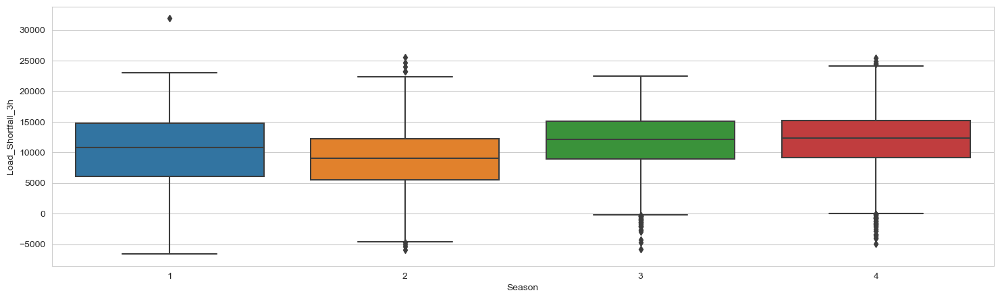

In [79]:
plt.figure(figsize=(18,5))
sns.boxplot(data=df_train, x='Season', y='Load_Shortfall_3h')
plt.show()

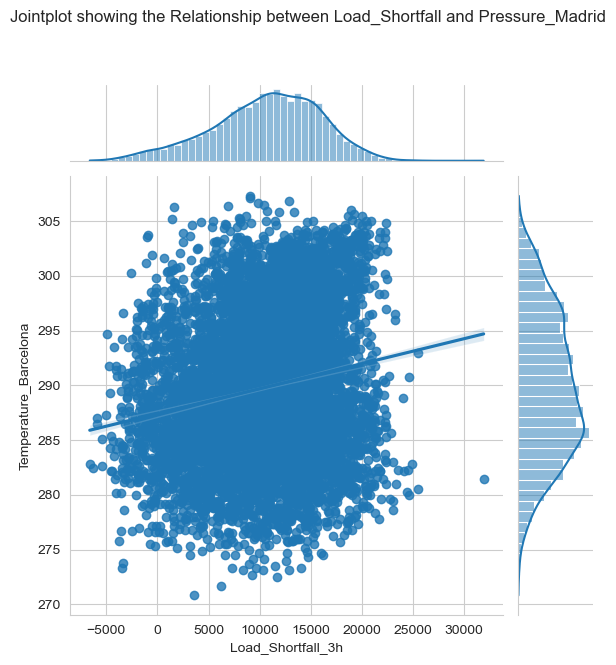

In [80]:
j = sns.jointplot(data=df_train, x='Load_Shortfall_3h', y='Temperature_Barcelona', kind='reg')
plt.suptitle('Jointplot showing the Relationship between Load_Shortfall and Pressure_Madrid', y=1.1)
plt.show()

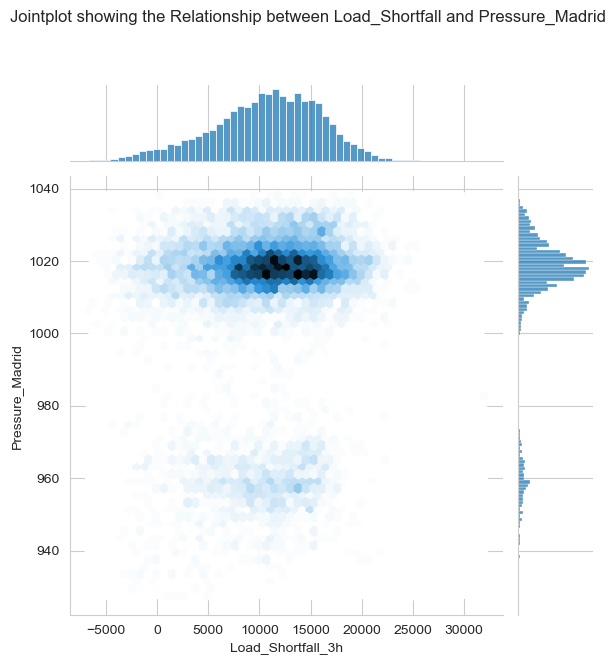

In [81]:
j = sns.jointplot(data=df_train, x='Load_Shortfall_3h', y='Pressure_Madrid', kind='hex')
plt.suptitle('Jointplot showing the Relationship between Load_Shortfall and Pressure_Madrid', y=1.1)
plt.show()

In [82]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat3.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T) # this removes the "count" column

                            mean   std     min     25%     50%     75%     max
Month                        8.2   3.8     1.0     6.0    11.0    11.0    12.0
Season                       2.8   1.3     1.0     1.0     3.0     4.0     4.0
Clouds_all_Bilboa           38.4  35.7     0.0     0.0    31.7    75.0    92.0
Clouds_all_Madrid           22.9  32.3     0.0     0.0     0.0    51.7    90.0
Clouds_all_Seville          13.7  23.4     0.0     0.0     0.0    25.3    85.7
Humidity_Madrid             57.1  26.4    12.3    31.7    62.7    82.3   100.0
Humidity_Seville            62.6  22.7    15.0    45.0    66.7    81.0    97.7
Humidity_Valencia           61.3  22.7    25.7    43.0    55.0    85.0   100.0
Pressure_Barcelona        1017.4   6.7  1002.0  1015.3  1018.3  1021.3  1032.3
Pressure_Bilboa           1018.9   7.2  1002.3  1015.0  1020.7  1023.0  1034.7
Pressure_Madrid           1015.2  14.8   940.0  1013.7  1019.0  1022.3  1033.3
Pressure_Seville            13.5   6.9     1.0     8

In [83]:
cat4 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 18000) & (df_train['Load_Shortfall_3h'] < 21000)]
count4 = len(cat4)
print(count4)

449


In [84]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat4.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T) # this removes the "count" column

                            mean   std     min     25%     50%     75%     max
Month                        7.7   3.4     1.0     6.0     7.0    11.0    12.0
Season                       2.8   1.1     1.0     2.0     3.0     4.0     4.0
Clouds_all_Bilboa           37.8  31.6     0.0     5.3    33.3    75.0    92.0
Clouds_all_Madrid           16.9  26.6     0.0     0.0     0.0    20.0    92.0
Clouds_all_Seville          10.8  21.0     0.0     0.0     0.0    10.0    92.0
Humidity_Madrid             50.4  26.0     6.7    27.7    48.3    74.0   100.0
Humidity_Seville            54.5  24.2    11.7    33.3    53.7    76.0   100.0
Humidity_Valencia           63.9  18.8    15.3    50.0    64.0    78.0   100.0
Pressure_Barcelona        1018.1   6.7   995.3  1014.3  1017.7  1022.0  1035.7
Pressure_Bilboa           1019.3   7.7   981.0  1015.3  1019.0  1023.7  1040.7
Pressure_Madrid           1016.6  13.5   937.3  1015.0  1018.0  1021.7  1037.3
Pressure_Seville            11.7   7.1     1.0     5

In [85]:
cat5 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 15000) & (df_train['Load_Shortfall_3h'] < 18000)]
count5 = len(cat5)
print(count5)

1330


In [86]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat5.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean   std     min     25%     50%     75%     max
Month                        7.2   3.5     1.0     5.0     8.0    10.0    12.0
Season                       2.6   1.2     1.0     1.0     3.0     4.0     4.0
Clouds_all_Bilboa           38.6  32.3     0.0     2.0    35.3    75.0    97.3
Clouds_all_Madrid           18.2  27.6     0.0     0.0     0.0    28.0   100.0
Clouds_all_Seville          11.8  22.4     0.0     0.0     0.0    13.3    92.0
Humidity_Madrid             53.9  25.4     8.3    31.0    53.7    77.0   100.0
Humidity_Seville            58.5  22.0    12.3    40.3    59.3    77.3   100.0
Humidity_Valencia           65.3  18.2    16.7    53.3    66.7    79.0   100.0
Pressure_Barcelona        1019.6   6.9   995.3  1015.7  1019.0  1024.0  1039.0
Pressure_Bilboa           1018.0  10.4   973.3  1014.3  1019.3  1024.0  1042.0
Pressure_Madrid           1012.6  20.4   941.7  1013.7  1018.0  1023.0  1037.0
Pressure_Seville            13.6   7.6     1.0     6

In [87]:
cat6 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 12000) & (df_train['Load_Shortfall_3h'] < 15000)]
count6 = len(cat6)
print(count6)

1901


In [88]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat6.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean   std     min     25%     50%     75%     max
Month                        6.9   3.3     1.0     4.0     7.0    10.0    12.0
Season                       2.7   1.1     1.0     2.0     3.0     4.0     4.0
Clouds_all_Bilboa           40.9  32.4     0.0     6.7    40.0    75.0   100.0
Clouds_all_Madrid           16.6  26.3     0.0     0.0     0.0    24.7   100.0
Clouds_all_Seville          11.7  22.7     0.0     0.0     0.0    12.0    92.0
Humidity_Madrid             54.9  24.8     6.3    33.3    54.0    77.0   100.0
Humidity_Seville            60.3  22.6     9.3    42.0    62.0    79.7   100.0
Humidity_Valencia           65.9  18.2    13.0    53.3    67.3    80.7   100.0
Pressure_Barcelona        1018.9   6.6   984.7  1015.0  1018.3  1022.0  1038.3
Pressure_Bilboa           1017.9  10.0   973.7  1014.3  1019.7  1024.0  1041.7
Pressure_Madrid           1010.7  22.1   933.7  1013.3  1018.0  1022.0  1038.0
Pressure_Seville            13.8   7.2     1.0     8

In [89]:
cat7 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 9000) & (df_train['Load_Shortfall_3h'] < 12000)]
count7 = len(cat7)
print(count7)

1975


In [90]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat7.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean   std    min    25%     50%     75%     max
Month                        6.6   3.3    1.0    4.0     7.0     9.0    12.0
Season                       2.6   1.1    1.0    2.0     3.0     4.0     4.0
Clouds_all_Bilboa           43.5  32.0    0.0   12.0    45.0    75.0    94.7
Clouds_all_Madrid           18.9  27.3    0.0    0.0     0.0    33.3   100.0
Clouds_all_Seville          13.6  24.2    0.0    0.0     0.0    20.0    97.3
Humidity_Madrid             57.1  23.9    8.0   37.0    56.0    78.0   100.0
Humidity_Seville            63.2  22.3   11.3   45.0    66.3    82.3   100.0
Humidity_Valencia           66.7  19.4   10.3   52.3    69.3    82.5   100.0
Pressure_Barcelona        1018.1   6.6  956.7 1014.3  1018.0  1021.7  1038.0
Pressure_Bilboa           1017.4   9.9  973.0 1013.0  1019.0  1023.7  1041.7
Pressure_Madrid           1009.7  22.9  931.3 1012.7  1017.3  1021.7  1037.7
Pressure_Seville            13.4   7.1    1.0    8.0    13.0    19.0    25.0

In [91]:
cat8 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 6000) & (df_train['Load_Shortfall_3h'] < 9000)]
count8 = len(cat8)
print(count8)

1417


In [92]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat8.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                           mean   std    min    25%    50%    75%    max
Month                       6.2   3.3    1.0    3.0    6.0    9.0   12.0
Season                      2.4   1.0    1.0    2.0    2.0    3.0    4.0
Clouds_all_Bilboa          45.8  32.3    0.0   13.3   50.0   75.0  100.0
Clouds_all_Madrid          20.8  29.0    0.0    0.0    0.0   36.0  100.0
Clouds_all_Seville         14.7  25.1    0.0    0.0    0.0   20.0   94.7
Humidity_Madrid            59.1  23.7   10.7   39.3   59.0   80.3  100.0
Humidity_Seville           64.4  22.4    9.7   46.7   67.3   83.7  100.0
Humidity_Valencia          66.2  19.9   11.0   52.0   68.7   83.0  100.0
Pressure_Barcelona       1017.2   8.2  934.7 1013.7 1017.7 1021.7 1038.0
Pressure_Bilboa          1017.3  10.3  975.0 1012.3 1018.7 1023.7 1040.7
Pressure_Madrid          1009.9  21.9  934.7 1011.3 1017.0 1021.3 1037.0
Pressure_Seville           13.1   7.1    1.0    7.0   13.0   19.0   25.0
Pressure_Valencia        1011.6   8.7  974.0 1012.0

In [93]:
cat9 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 3000) & (df_train['Load_Shortfall_3h'] < 6000)]
count9 = len(cat9)
print(count9)

816


In [94]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat9.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                           mean   std    min    25%    50%    75%    max
Month                       5.4   3.5    1.0    3.0    5.0    8.0   12.0
Season                      2.1   1.0    1.0    1.0    2.0    3.0    4.0
Clouds_all_Bilboa          48.9  33.2    0.0   16.2   57.3   75.0   94.7
Clouds_all_Madrid          22.4  30.2    0.0    0.0    1.3   40.0   92.0
Clouds_all_Seville         16.2  26.3    0.0    0.0    0.0   22.1   97.3
Humidity_Madrid            63.8  21.7   12.0   47.9   65.0   81.3  100.0
Humidity_Seville           67.4  21.7    9.3   51.6   72.2   86.7  100.0
Humidity_Valencia          63.7  20.3   15.3   47.2   64.7   82.0  100.0
Pressure_Barcelona       1016.9   8.3  984.0 1013.2 1017.3 1021.3 1038.0
Pressure_Bilboa          1018.4  10.0  973.7 1013.0 1019.7 1025.0 1040.0
Pressure_Madrid          1007.2  24.8  927.7 1008.7 1017.0 1021.7 1036.0
Pressure_Seville           13.9   7.3    1.0    8.0   14.0   21.0   25.0
Pressure_Valencia        1011.6   8.6  976.0 1011.6

In [95]:
cat10 = df_train.loc[(df_train['Load_Shortfall_3h'] >= 0) & (df_train['Load_Shortfall_3h'] < 3000)]
count10 = len(cat10)
print(count10)

472


In [96]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat10.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                           mean   std   min    25%    50%    75%    max
Month                       5.3   3.5   1.0    3.0    4.0    8.0   12.0
Season                      2.1   1.0   1.0    1.0    2.0    3.0    4.0
Clouds_all_Bilboa          50.2  33.1   0.0   20.0   59.2   75.8   93.7
Clouds_all_Madrid          25.4  29.7   0.0    0.0   13.3   49.0   92.0
Clouds_all_Seville         18.1  26.6   0.0    0.0    0.0   30.0   92.0
Humidity_Madrid            64.5  21.8  10.0   48.0   66.0   82.3  100.0
Humidity_Seville           70.0  21.3  15.7   55.3   74.5   88.1  100.0
Humidity_Valencia          62.3  20.1  14.3   46.6   63.2   78.4  100.0
Pressure_Barcelona       1016.0   8.6 985.0 1011.3 1017.3 1021.0 1037.0
Pressure_Bilboa          1018.0  10.1 972.7 1011.2 1019.3 1025.0 1039.7
Pressure_Madrid          1008.2  24.0 928.0 1010.2 1017.0 1022.0 1037.3
Pressure_Seville           14.3   7.3   1.0    8.0   15.0   21.0   25.0
Pressure_Valencia        1011.5   8.0 980.0 1010.7 1012.1 1017.0

In [97]:
cat11 = df_train.loc[(df_train['Load_Shortfall_3h'] <= 0) & (df_train['Load_Shortfall_3h'] > -3000)]
count11 = len(cat11)
print(count11)

261


In [98]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat11.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean   std     min     25%     50%    75%    max
Month                        5.0   3.3     1.0     2.0     4.0    7.0   12.0
Season                       2.0   1.0     1.0     1.0     2.0    3.0    4.0
Clouds_all_Bilboa           54.1  30.0     0.0    30.0    58.7   75.0   94.7
Clouds_all_Madrid           26.1  30.3     0.0     0.0    13.3   48.3   92.0
Clouds_all_Seville          21.3  30.1     0.0     0.0     0.0   34.7   92.0
Humidity_Madrid             63.9  22.0    10.0    50.3    66.3   82.0  100.0
Humidity_Seville            70.5  21.1     8.3    57.0    75.7   87.0  100.0
Humidity_Valencia           59.4  20.3    15.0    44.3    59.7   76.0  100.0
Pressure_Barcelona        1014.4   9.2   982.3  1010.0  1015.7 1019.3 1039.0
Pressure_Bilboa           1015.5  11.6   971.3  1007.7  1017.0 1023.7 1038.0
Pressure_Madrid           1004.6  26.3   929.0  1006.0  1015.7 1019.7 1033.3
Pressure_Seville            13.6   7.3     1.0     8.0    14.0   20.0   25.0

In [99]:
cat12 = df_train.loc[(df_train['Load_Shortfall_3h'] <= -3000) & (df_train['Load_Shortfall_3h'] > -6000)]
count12 = len(cat12)
print(count12)

54


In [100]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat12.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean   std     min     25%     50%     75%     max
Month                        5.4   3.9     1.0     2.0     4.0    10.0    12.0
Season                       1.9   1.0     1.0     1.0     2.0     2.0     4.0
Clouds_all_Bilboa           52.5  29.0     0.0    38.5    63.3    75.0    92.0
Clouds_all_Madrid           25.9  28.3     0.0     0.0    12.0    45.2    92.0
Clouds_all_Seville          17.8  27.9     0.0     0.0     0.0    31.3    92.0
Humidity_Madrid             67.1  18.6    22.7    54.7    66.0    83.0   100.0
Humidity_Seville            71.5  18.9    33.3    57.2    74.5    88.3   100.0
Humidity_Valencia           58.4  19.5    23.3    43.8    59.2    68.5   100.0
Pressure_Barcelona        1012.0  10.0   987.3  1005.0  1012.2  1018.8  1038.3
Pressure_Bilboa           1014.7  10.9   994.0  1004.8  1016.7  1022.6  1037.0
Pressure_Madrid           1010.5  19.7   933.0  1008.0  1017.0  1021.2  1033.0
Pressure_Seville            13.8   7.0     1.0     8

In [101]:
cat13 = df_train.loc[(df_train['Load_Shortfall_3h'] <= -6000) & (df_train['Load_Shortfall_3h'] > -9000)]
count13 = len(cat13)
print(count13)
cat13

2


,Date_Time,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_direction_Valencia,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia,Load_Shortfall_3h
2953,2016-01-05 18:00:00,1,1,32.0,23.333333,29.0,54.333333,77.666667,51.000000,1003.0,1005.333333,1008.666667,10,1006.333333,0.2,0.1,0.1,0.0,0.0,0.0,0.0,0.0,284.623500,282.339333,280.402667,290.961667,283.856833,279.063500,278.339333,279.202667,283.295000,279.536833,282.816833,280.112667,279.702667,286.255000,281.733500,600.000000,700.666667,701.000000,801.333333,278.000000,289.333333,level_9,4.666667,3.666667,6.0,4.000000,6.0,-6618.000000
8725,2017-12-27 06:00:00,12,1,75.0,33.333333,80.0,68.666667,78.666667,63.333333,998.0,1001.333333,1006.666667,8,1003.000000,0.1,0.7,0.0,0.3,0.0,0.0,0.0,0.0,282.483333,282.816667,281.150000,289.483333,286.816667,282.483333,278.816667,280.150000,286.816667,286.816667,282.483333,280.513333,280.586667,287.956667,286.816667,701.333333,500.666667,801.666667,702.333333,256.666667,286.666667,level_9,4.666667,8.666667,8.0,7.666667,11.0,-6292.666667


In [102]:
with pd.option_context("float_format", '{:.1f}'.format): print(cat13.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                            mean   std     min     25%     50%     75%     max
Month                        6.5   7.8     1.0     3.8     6.5     9.2    12.0
Season                       1.0   0.0     1.0     1.0     1.0     1.0     1.0
Clouds_all_Bilboa           53.5  30.4    32.0    42.8    53.5    64.2    75.0
Clouds_all_Madrid           28.3   7.1    23.3    25.8    28.3    30.8    33.3
Clouds_all_Seville          54.5  36.1    29.0    41.8    54.5    67.2    80.0
Humidity_Madrid             61.5  10.1    54.3    57.9    61.5    65.1    68.7
Humidity_Seville            78.2   0.7    77.7    77.9    78.2    78.4    78.7
Humidity_Valencia           57.2   8.7    51.0    54.1    57.2    60.2    63.3
Pressure_Barcelona        1000.5   3.5   998.0   999.2  1000.5  1001.8  1003.0
Pressure_Bilboa           1003.3   2.8  1001.3  1002.3  1003.3  1004.3  1005.3
Pressure_Madrid           1007.7   1.4  1006.7  1007.2  1007.7  1008.2  1008.7
Pressure_Seville             9.0   1.4     8.0     8

In [103]:
df_train['Avg_Temp'] = df_train[['Temperature_Barcelona','Temperature_Bilboa','Temperature_Madrid','Temperature_Seville','Temperature_Valencia']].mean(axis=1)
df_train['Avg_Temp_Min'] = df_train[['Temp_min_Barcelona','Temp_min_Bilboa','Temp_min_Madrid','Temp_min_Seville','Temp_min_Valencia']].mean(axis=1)
df_train['Avg_Temp_Max'] = df_train[['Temp_max_Barcelona','Temp_max_Bilboa','Temp_max_Madrid','Temp_max_Seville','Temp_max_Valencia']].mean(axis=1)
df_train['Avg_Pressure'] = df_train[['Pressure_Barcelona','Pressure_Bilboa','Pressure_Madrid','Pressure_Valencia']].mean(axis=1)
df_train['Avg_Wind_speed'] = df_train[['Wind_speed_Barcelona', 'Wind_speed_Bilboa','Wind_speed_Madrid','Wind_speed_Seville','Wind_speed_Valencia']].mean(axis=1)
df_train['Avg_Wind_direction'] = df_train[['Wind_direction_Barcelona', 'Wind_direction_Bilboa']].mean(axis=1)
df_train['Avg_Weather_id'] = df_train[['Weather_id_Barcelona', 'Weather_id_Bilboa','Weather_id_Madrid','Weather_id_Seville']].mean(axis=1)
df_train['Avg_Clouds_all'] = df_train[['Clouds_all_Bilboa','Clouds_all_Madrid','Clouds_all_Seville']].mean(axis=1)
df_train['Avg_Humidity'] = df_train[['Clouds_all_Bilboa','Clouds_all_Madrid','Clouds_all_Seville']].mean(axis=1)
df_train['Avg_Rain_3h'] = df_train[['Rain_3h_Barcelona','Rain_3h_Seville']].mean(axis=1)
df_train['Avg_Rain_1h'] = df_train[['Rain_1h_Barcelona','Rain_1h_Bilboa','Rain_1h_Madrid','Rain_1h_Seville']].mean(axis=1)
df_train['Avg_Snow_3h'] = df_train[['Snow_3h_Bilboa','Snow_3h_Valencia']].mean(axis=1)

In [104]:
col_all = df_train.columns
print(col_all)

Index(['Date_Time', 'Month', 'Season', 'Clouds_all_Bilboa',
       'Clouds_all_Madrid', 'Clouds_all_Seville', 'Humidity_Madrid',
       'Humidity_Seville', 'Humidity_Valencia', 'Pressure_Barcelona',
       'Pressure_Bilboa', 'Pressure_Madrid', 'Pressure_Seville',
       'Pressure_Valencia', 'Rain_1h_Barcelona', 'Rain_1h_Bilboa',
       'Rain_1h_Madrid', 'Rain_1h_Seville', 'Rain_3h_Barcelona',
       'Rain_3h_Seville', 'Snow_3h_Bilboa', 'Snow_3h_Valencia',
       'Temp_max_Barcelona', 'Temp_max_Bilboa', 'Temp_max_Madrid',
       'Temp_max_Seville', 'Temp_max_Valencia', 'Temp_min_Barcelona',
       'Temp_min_Bilboa', 'Temp_min_Madrid', 'Temp_min_Seville',
       'Temp_min_Valencia', 'Temperature_Barcelona', 'Temperature_Bilboa',
       'Temperature_Madrid', 'Temperature_Seville', 'Temperature_Valencia',
       'Weather_id_Barcelona', 'Weather_id_Bilboa', 'Weather_id_Madrid',
       'Weather_id_Seville', 'Wind_direction_Barcelona',
       'Wind_direction_Bilboa', 'Wind_direction_Valencia'

In [105]:
col_avg = ['Month', 'Season','Avg_Temp', 'Avg_Temp_Min', 'Avg_Temp_Max', 'Avg_Pressure',
       'Avg_Wind_speed', 'Avg_Wind_direction', 'Avg_Weather_id','Avg_Clouds_all', 'Avg_Humidity', 'Avg_Rain_3h',
       'Avg_Rain_1h','Avg_Snow_3h','Load_Shortfall_3h']

In [106]:
df_train1 = df_train[col_avg]
df_train1.head()

,Month,Season,Avg_Temp,Avg_Temp_Min,Avg_Temp_Max,Avg_Pressure,Avg_Wind_speed,Avg_Wind_direction,Avg_Weather_id,Avg_Clouds_all,Avg_Humidity,Avg_Rain_3h,Avg_Rain_1h,Avg_Snow_3h,Load_Shortfall_3h
0,1,1,272.086456,272.086456,272.086456,1011.333333,2.400000,133.000000,800.0,0.000000,0.000000,0.0,0.0,0.0,6715.666667
1,1,1,272.799533,272.799533,272.799533,1012.500000,2.066667,180.000000,800.0,0.000000,0.000000,0.0,0.0,0.0,4171.666667
2,1,1,277.224046,277.224046,277.224046,1013.333333,1.533333,270.166667,800.0,0.000000,0.000000,0.0,0.0,0.0,4274.666667
3,1,1,283.351587,283.351587,283.351587,1019.166667,1.866667,236.333333,800.0,0.000000,0.000000,0.0,0.0,0.0,5075.666667
4,1,1,283.134500,283.134500,283.134500,1029.429518,1.933333,222.500000,800.0,0.666667,0.666667,0.0,0.0,0.0,6620.666667


In [107]:
with pd.option_context("float_format", '{:.1f}'.format): print(df_train1.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                      mean    std     min    25%     50%     75%     max
Month                  6.5    3.4     1.0    4.0     7.0    10.0    12.0
Season                 2.5    1.1     1.0    2.0     3.0     3.0     4.0
Avg_Temp             289.9    7.2   272.1  284.3   289.2   295.3   309.1
Avg_Temp_Min         288.4    7.0   271.1  283.1   287.8   293.6   307.3
Avg_Temp_Max         291.5    7.5   272.1  285.7   290.8   297.2   312.6
Avg_Pressure        1014.5    9.3   973.6 1011.6  1017.0  1020.5  1031.3
Avg_Wind_speed         2.4    1.3     0.3    1.5     2.1     3.1    14.9
Avg_Wind_direction   174.8   67.2     0.0  124.8   177.7   225.0   343.5
Avg_Weather_id       759.7   54.1   495.7  726.2   781.9   800.5   803.7
Avg_Clouds_all        25.6   19.6     0.0    8.9    25.0    35.9    92.0
Avg_Humidity          25.6   19.6     0.0    8.9    25.0    35.9    92.0
Avg_Rain_3h            0.0    0.0     0.0    0.0     0.0     0.0     0.1
Avg_Rain_1h            0.1    0.2     0.0    0.0   

In [108]:
#bins = [925,940,955,970,985,1000,1015,1030,1045,1060]
#labels = [1,2,3,4,5,6,7,8,9]

#df_train1['Pressure_Bin'] = pd.cut(x = df_train1['Avg_Pressure'],bins = bins,labels = labels)

In [109]:
df_test = pd.read_csv("df_test.csv")
df_test.head()

,Unnamed: 0,time,Madrid_wind_speed,Valencia_wind_deg,Bilbao_rain_1h,Valencia_wind_speed,Seville_humidity,Madrid_humidity,Bilbao_clouds_all,Bilbao_wind_speed,Seville_clouds_all,Bilbao_wind_deg,Barcelona_wind_speed,Barcelona_wind_deg,Madrid_clouds_all,Seville_wind_speed,Barcelona_rain_1h,Seville_pressure,Seville_rain_1h,Bilbao_snow_3h,Barcelona_pressure,Seville_rain_3h,Madrid_rain_1h,Barcelona_rain_3h,Valencia_snow_3h,Madrid_weather_id,Barcelona_weather_id,Bilbao_pressure,Seville_weather_id,Valencia_pressure,Seville_temp_max,Madrid_pressure,Valencia_temp_max,Valencia_temp,Bilbao_weather_id,Seville_temp,Valencia_humidity,Valencia_temp_min,Barcelona_temp_max,Madrid_temp_max,Barcelona_temp,Bilbao_temp_min,Bilbao_temp,Barcelona_temp_min,Bilbao_temp_max,Seville_temp_min,Madrid_temp,Madrid_temp_min
0,8763,2018-01-01 00:00:00,5.000000,level_8,0.0,5.000000,87.000000,71.333333,20.000000,3.000000,0.000000,193.333333,4.000000,176.666667,0.0,1.000000,0.0,sp25,0.0,0,1017.333333,0.0,0.0,0.0,0,800.0,800.000000,1025.666667,800.000000,NaN,284.483333,1030.000000,287.483333,287.483333,801.000000,283.673333,46.333333,287.483333,287.816667,280.816667,287.356667,276.150000,280.380000,286.816667,285.150000,283.150000,279.866667,279.150000
1,8764,2018-01-01 03:00:00,4.666667,level_8,0.0,5.333333,89.000000,78.000000,0.000000,3.666667,0.000000,143.333333,4.666667,266.666667,0.0,0.666667,0.0,sp25,0.0,0,1020.333333,0.0,0.0,0.0,0,800.0,800.333333,1026.666667,800.000000,NaN,282.483333,1030.333333,284.150000,284.150000,721.000000,281.673333,53.666667,284.150000,284.816667,280.483333,284.190000,277.816667,281.010000,283.483333,284.150000,281.150000,279.193333,278.150000
2,8765,2018-01-01 06:00:00,2.333333,level_7,0.0,5.000000,89.000000,89.666667,0.000000,2.333333,6.666667,130.000000,4.000000,263.333333,0.0,0.666667,0.0,sp25,0.0,0,1023.000000,0.0,0.0,0.0,0,800.0,800.000000,1025.333333,800.333333,NaN,280.816667,1030.666667,282.816667,282.816667,800.000000,280.613333,42.000000,282.816667,284.483333,276.483333,283.150000,276.816667,279.196667,281.816667,282.150000,280.483333,276.340000,276.150000
3,8766,2018-01-01 09:00:00,2.666667,level_7,0.0,5.333333,93.333333,82.666667,26.666667,5.666667,6.666667,196.666667,2.333333,86.666667,0.0,1.333333,0.0,sp25,0.0,0,1025.666667,0.0,0.0,0.0,0,800.0,800.000000,1025.000000,800.333333,NaN,281.150000,1032.333333,283.483333,283.483333,801.333333,279.936667,45.000000,283.483333,284.150000,277.150000,283.190000,279.150000,281.740000,282.150000,284.483333,279.150000,275.953333,274.483333
4,8767,2018-01-01 12:00:00,4.000000,level_7,0.0,8.666667,65.333333,64.000000,26.666667,10.666667,0.000000,233.333333,4.666667,283.333333,0.0,1.000000,0.0,sp25,0.0,0,1026.000000,0.0,0.0,0.0,0,800.0,800.333333,1022.333333,800.000000,NaN,287.150000,1032.333333,287.150000,287.150000,801.333333,285.570000,41.000000,287.150000,287.483333,281.150000,286.816667,281.816667,284.116667,286.150000,286.816667,284.483333,280.686667,280.150000


In [110]:
df_test.isnull().sum()

Unnamed: 0                0
time                      0
Madrid_wind_speed         0
Valencia_wind_deg         0
Bilbao_rain_1h            0
Valencia_wind_speed       0
Seville_humidity          0
Madrid_humidity           0
Bilbao_clouds_all         0
Bilbao_wind_speed         0
Seville_clouds_all        0
Bilbao_wind_deg           0
Barcelona_wind_speed      0
Barcelona_wind_deg        0
Madrid_clouds_all         0
Seville_wind_speed        0
Barcelona_rain_1h         0
Seville_pressure          0
Seville_rain_1h           0
Bilbao_snow_3h            0
Barcelona_pressure        0
Seville_rain_3h           0
Madrid_rain_1h            0
Barcelona_rain_3h         0
Valencia_snow_3h          0
Madrid_weather_id         0
Barcelona_weather_id      0
Bilbao_pressure           0
Seville_weather_id        0
Valencia_pressure       454
Seville_temp_max          0
Madrid_pressure           0
Valencia_temp_max         0
Valencia_temp             0
Bilbao_weather_id         0
Seville_temp        

In [111]:
# df_test.describe().T
with pd.option_context("float_format", '{:.1f}'.format): print(df_test.describe().loc[["mean", "std", "min", "25%", "50%", "75%", "max"]].T)

                        mean   std    min    25%     50%     75%     max
Unnamed: 0           10222.5 843.1 8763.0 9492.8 10222.5 10952.2 11682.0
Madrid_wind_speed        2.5   1.8    0.0    1.3     2.0     3.3    13.3
Bilbao_rain_1h           0.1   0.2    0.0    0.0     0.0     0.0     1.6
Valencia_wind_speed      3.0   2.0    0.0    1.7     2.3     4.0    14.3
Seville_humidity        67.1  20.6   11.7   52.0    70.3    85.0   100.0
Madrid_humidity         62.6  24.1    8.0   43.0    63.0    84.0   100.0
Bilbao_clouds_all       43.4  30.5    0.0   13.3    45.0    75.0    97.3
Bilbao_wind_speed        2.3   1.7    0.0    1.0     1.7     3.3    10.7
Seville_clouds_all      15.5  25.3    0.0    0.0     0.0    20.0    93.3
Bilbao_wind_deg        162.6  97.7    0.0   86.7   140.0   233.3   360.0
Barcelona_wind_speed     2.5   1.6    0.0    1.3     2.0     3.7    12.7
Barcelona_wind_deg     179.0  87.0    0.0  113.3   176.7   253.3   343.3
Madrid_clouds_all       24.3  29.4    0.0    0.0   

In [112]:
df_test.columns

Index(['Unnamed: 0', 'time', 'Madrid_wind_speed', 'Valencia_wind_deg',
       'Bilbao_rain_1h', 'Valencia_wind_speed', 'Seville_humidity',
       'Madrid_humidity', 'Bilbao_clouds_all', 'Bilbao_wind_speed',
       'Seville_clouds_all', 'Bilbao_wind_deg', 'Barcelona_wind_speed',
       'Barcelona_wind_deg', 'Madrid_clouds_all', 'Seville_wind_speed',
       'Barcelona_rain_1h', 'Seville_pressure', 'Seville_rain_1h',
       'Bilbao_snow_3h', 'Barcelona_pressure', 'Seville_rain_3h',
       'Madrid_rain_1h', 'Barcelona_rain_3h', 'Valencia_snow_3h',
       'Madrid_weather_id', 'Barcelona_weather_id', 'Bilbao_pressure',
       'Seville_weather_id', 'Valencia_pressure', 'Seville_temp_max',
       'Madrid_pressure', 'Valencia_temp_max', 'Valencia_temp',
       'Bilbao_weather_id', 'Seville_temp', 'Valencia_humidity',
       'Valencia_temp_min', 'Barcelona_temp_max', 'Madrid_temp_max',
       'Barcelona_temp', 'Bilbao_temp_min', 'Bilbao_temp',
       'Barcelona_temp_min', 'Bilbao_temp_max', 'Sev

In [113]:
df_test = df_test.drop(["Unnamed: 0"], axis = 1)

In [114]:
df_test['Month'] = pd.DatetimeIndex(df_test['time']).month

In [115]:
season_dict = {1: 1,
               2: 1,
               3: 2, 
               4: 2,
               5: 2,
               6: 3,
               7: 3,
               8: 3,
               9: 4,
               10: 4,
               11: 4,
               12: 1}
df_test['Season'] = df_test['Month'].apply(lambda x: season_dict[x])

In [116]:
columns_old1 = df_test.columns.values.tolist()
print(columns_old1)
print(len(columns_old1))

['time', 'Madrid_wind_speed', 'Valencia_wind_deg', 'Bilbao_rain_1h', 'Valencia_wind_speed', 'Seville_humidity', 'Madrid_humidity', 'Bilbao_clouds_all', 'Bilbao_wind_speed', 'Seville_clouds_all', 'Bilbao_wind_deg', 'Barcelona_wind_speed', 'Barcelona_wind_deg', 'Madrid_clouds_all', 'Seville_wind_speed', 'Barcelona_rain_1h', 'Seville_pressure', 'Seville_rain_1h', 'Bilbao_snow_3h', 'Barcelona_pressure', 'Seville_rain_3h', 'Madrid_rain_1h', 'Barcelona_rain_3h', 'Valencia_snow_3h', 'Madrid_weather_id', 'Barcelona_weather_id', 'Bilbao_pressure', 'Seville_weather_id', 'Valencia_pressure', 'Seville_temp_max', 'Madrid_pressure', 'Valencia_temp_max', 'Valencia_temp', 'Bilbao_weather_id', 'Seville_temp', 'Valencia_humidity', 'Valencia_temp_min', 'Barcelona_temp_max', 'Madrid_temp_max', 'Barcelona_temp', 'Bilbao_temp_min', 'Bilbao_temp', 'Barcelona_temp_min', 'Bilbao_temp_max', 'Seville_temp_min', 'Madrid_temp', 'Madrid_temp_min', 'Month', 'Season']
49


In [117]:
columns_new1  = ['Date_Time', 'Wind_speed_Madrid', 'Wind_direction_Valencia', 'Rain_1h_Bilboa', 'Wind_speed_Valencia', 'Humidity_Seville', 'Humidity_Madrid', 'Clouds_all_Bilboa', 'Wind_speed_Bilboa', 'Clouds_all_Seville', 'Wind_direction_Bilboa', 'Wind_speed_Barcelona', 'Wind_direction_Barcelona', 'Clouds_all_Madrid', 'Wind_speed_Seville', 'Rain_1h_Barcelona', 'Pressure_Seville', 'Rain_1h_Seville', 'Snow_3h_Bilboa', 'Pressure_Barcelona', 'Rain_3h_Seville', 'Rain_1h_Madrid', 'Rain_3h_Barcelona', 'Snow_3h_Valencia', 'Weather_id_Madrid', 'Weather_id_Barcelona', 'Pressure_Bilboa', 'Weather_id_Seville', 'Pressure_Valencia', 'Temp_max_Seville', 'Pressure_Madrid', 'Temp_max_Valencia', 'Temperature_Valencia', 'Weather_id_Bilboa', 'Temperature_Seville', 'Humidity_Valencia', 'Temp_min_Valencia', 'Temp_max_Barcelona', 'Temp_max_Madrid', 'Temperature_Barcelona', 'Temp_min_Bilboa', 'Temperature_Bilboa', 'Temp_min_Barcelona', 'Temp_max_Bilboa', 'Temp_min_Seville', 'Temperature_Madrid', 'Temp_min_Madrid','Month','Season']
print(columns_new1)
print(len(columns_new1))

['Date_Time', 'Wind_speed_Madrid', 'Wind_direction_Valencia', 'Rain_1h_Bilboa', 'Wind_speed_Valencia', 'Humidity_Seville', 'Humidity_Madrid', 'Clouds_all_Bilboa', 'Wind_speed_Bilboa', 'Clouds_all_Seville', 'Wind_direction_Bilboa', 'Wind_speed_Barcelona', 'Wind_direction_Barcelona', 'Clouds_all_Madrid', 'Wind_speed_Seville', 'Rain_1h_Barcelona', 'Pressure_Seville', 'Rain_1h_Seville', 'Snow_3h_Bilboa', 'Pressure_Barcelona', 'Rain_3h_Seville', 'Rain_1h_Madrid', 'Rain_3h_Barcelona', 'Snow_3h_Valencia', 'Weather_id_Madrid', 'Weather_id_Barcelona', 'Pressure_Bilboa', 'Weather_id_Seville', 'Pressure_Valencia', 'Temp_max_Seville', 'Pressure_Madrid', 'Temp_max_Valencia', 'Temperature_Valencia', 'Weather_id_Bilboa', 'Temperature_Seville', 'Humidity_Valencia', 'Temp_min_Valencia', 'Temp_max_Barcelona', 'Temp_max_Madrid', 'Temperature_Barcelona', 'Temp_min_Bilboa', 'Temperature_Bilboa', 'Temp_min_Barcelona', 'Temp_max_Bilboa', 'Temp_min_Seville', 'Temperature_Madrid', 'Temp_min_Madrid', 'Month', '

In [118]:
df_test.columns = columns_new1
print(df_test.columns)

Index(['Date_Time', 'Wind_speed_Madrid', 'Wind_direction_Valencia',
       'Rain_1h_Bilboa', 'Wind_speed_Valencia', 'Humidity_Seville',
       'Humidity_Madrid', 'Clouds_all_Bilboa', 'Wind_speed_Bilboa',
       'Clouds_all_Seville', 'Wind_direction_Bilboa', 'Wind_speed_Barcelona',
       'Wind_direction_Barcelona', 'Clouds_all_Madrid', 'Wind_speed_Seville',
       'Rain_1h_Barcelona', 'Pressure_Seville', 'Rain_1h_Seville',
       'Snow_3h_Bilboa', 'Pressure_Barcelona', 'Rain_3h_Seville',
       'Rain_1h_Madrid', 'Rain_3h_Barcelona', 'Snow_3h_Valencia',
       'Weather_id_Madrid', 'Weather_id_Barcelona', 'Pressure_Bilboa',
       'Weather_id_Seville', 'Pressure_Valencia', 'Temp_max_Seville',
       'Pressure_Madrid', 'Temp_max_Valencia', 'Temperature_Valencia',
       'Weather_id_Bilboa', 'Temperature_Seville', 'Humidity_Valencia',
       'Temp_min_Valencia', 'Temp_max_Barcelona', 'Temp_max_Madrid',
       'Temperature_Barcelona', 'Temp_min_Bilboa', 'Temperature_Bilboa',
       'Temp_mi

In [119]:
first_col1 = [columns_new1[0]]
sort_col1 = sorted(columns_new1[1:-2])
other_col1 = columns_new1[-2:]
cols1 = first_col1 + other_col1 + sort_col1
print(cols1)


['Date_Time', 'Month', 'Season', 'Clouds_all_Bilboa', 'Clouds_all_Madrid', 'Clouds_all_Seville', 'Humidity_Madrid', 'Humidity_Seville', 'Humidity_Valencia', 'Pressure_Barcelona', 'Pressure_Bilboa', 'Pressure_Madrid', 'Pressure_Seville', 'Pressure_Valencia', 'Rain_1h_Barcelona', 'Rain_1h_Bilboa', 'Rain_1h_Madrid', 'Rain_1h_Seville', 'Rain_3h_Barcelona', 'Rain_3h_Seville', 'Snow_3h_Bilboa', 'Snow_3h_Valencia', 'Temp_max_Barcelona', 'Temp_max_Bilboa', 'Temp_max_Madrid', 'Temp_max_Seville', 'Temp_max_Valencia', 'Temp_min_Barcelona', 'Temp_min_Bilboa', 'Temp_min_Madrid', 'Temp_min_Seville', 'Temp_min_Valencia', 'Temperature_Barcelona', 'Temperature_Bilboa', 'Temperature_Madrid', 'Temperature_Seville', 'Temperature_Valencia', 'Weather_id_Barcelona', 'Weather_id_Bilboa', 'Weather_id_Madrid', 'Weather_id_Seville', 'Wind_direction_Barcelona', 'Wind_direction_Bilboa', 'Wind_direction_Valencia', 'Wind_speed_Barcelona', 'Wind_speed_Bilboa', 'Wind_speed_Madrid', 'Wind_speed_Seville', 'Wind_speed_Va

In [120]:
df_test = df_test[cols1]
df_test.head()

,Date_Time,Month,Season,Clouds_all_Bilboa,Clouds_all_Madrid,Clouds_all_Seville,Humidity_Madrid,Humidity_Seville,Humidity_Valencia,Pressure_Barcelona,Pressure_Bilboa,Pressure_Madrid,Pressure_Seville,Pressure_Valencia,Rain_1h_Barcelona,Rain_1h_Bilboa,Rain_1h_Madrid,Rain_1h_Seville,Rain_3h_Barcelona,Rain_3h_Seville,Snow_3h_Bilboa,Snow_3h_Valencia,Temp_max_Barcelona,Temp_max_Bilboa,Temp_max_Madrid,Temp_max_Seville,Temp_max_Valencia,Temp_min_Barcelona,Temp_min_Bilboa,Temp_min_Madrid,Temp_min_Seville,Temp_min_Valencia,Temperature_Barcelona,Temperature_Bilboa,Temperature_Madrid,Temperature_Seville,Temperature_Valencia,Weather_id_Barcelona,Weather_id_Bilboa,Weather_id_Madrid,Weather_id_Seville,Wind_direction_Barcelona,Wind_direction_Bilboa,Wind_direction_Valencia,Wind_speed_Barcelona,Wind_speed_Bilboa,Wind_speed_Madrid,Wind_speed_Seville,Wind_speed_Valencia
0,2018-01-01 00:00:00,1,1,20.000000,0.0,0.000000,71.333333,87.000000,46.333333,1017.333333,1025.666667,1030.000000,sp25,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,287.816667,285.150000,280.816667,284.483333,287.483333,286.816667,276.150000,279.150000,283.150000,287.483333,287.356667,280.380000,279.866667,283.673333,287.483333,800.000000,801.000000,800.0,800.000000,176.666667,193.333333,level_8,4.000000,3.000000,5.000000,1.000000,5.000000
1,2018-01-01 03:00:00,1,1,0.000000,0.0,0.000000,78.000000,89.000000,53.666667,1020.333333,1026.666667,1030.333333,sp25,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,284.816667,284.150000,280.483333,282.483333,284.150000,283.483333,277.816667,278.150000,281.150000,284.150000,284.190000,281.010000,279.193333,281.673333,284.150000,800.333333,721.000000,800.0,800.000000,266.666667,143.333333,level_8,4.666667,3.666667,4.666667,0.666667,5.333333
2,2018-01-01 06:00:00,1,1,0.000000,0.0,6.666667,89.666667,89.000000,42.000000,1023.000000,1025.333333,1030.666667,sp25,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,284.483333,282.150000,276.483333,280.816667,282.816667,281.816667,276.816667,276.150000,280.483333,282.816667,283.150000,279.196667,276.340000,280.613333,282.816667,800.000000,800.000000,800.0,800.333333,263.333333,130.000000,level_7,4.000000,2.333333,2.333333,0.666667,5.000000
3,2018-01-01 09:00:00,1,1,26.666667,0.0,6.666667,82.666667,93.333333,45.000000,1025.666667,1025.000000,1032.333333,sp25,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,284.150000,284.483333,277.150000,281.150000,283.483333,282.150000,279.150000,274.483333,279.150000,283.483333,283.190000,281.740000,275.953333,279.936667,283.483333,800.000000,801.333333,800.0,800.333333,86.666667,196.666667,level_7,2.333333,5.666667,2.666667,1.333333,5.333333
4,2018-01-01 12:00:00,1,1,26.666667,0.0,0.000000,64.000000,65.333333,41.000000,1026.000000,1022.333333,1032.333333,sp25,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,287.483333,286.816667,281.150000,287.150000,287.150000,286.150000,281.816667,280.150000,284.483333,287.150000,286.816667,284.116667,280.686667,285.570000,287.150000,800.333333,801.333333,800.0,800.000000,283.333333,233.333333,level_7,4.666667,10.666667,4.000000,1.000000,8.666667


In [121]:
pressure_val_mean1 = df_test['Pressure_Valencia'][df_test['Pressure_Valencia'].between(920,1070)].mean()
print(pressure_val_mean1)

1013.1483509056495


In [122]:
df_test.loc[df_test['Pressure_Valencia'].isna(),'Pressure_Valencia']=pressure_val_mean1

In [151]:
df_test['Avg_Temp'] = df_test[['Temperature_Barcelona','Temperature_Bilboa','Temperature_Madrid','Temperature_Seville','Temperature_Valencia']].mean(axis=1)
df_test['Avg_Temp_Min'] = df_test[['Temp_min_Barcelona','Temp_min_Bilboa','Temp_min_Madrid','Temp_min_Seville','Temp_min_Valencia']].mean(axis=1)
df_test['Avg_Temp_Max'] = df_test[['Temp_max_Barcelona','Temp_max_Bilboa','Temp_max_Madrid','Temp_max_Seville','Temp_max_Valencia']].mean(axis=1)
df_test['Avg_Pressure'] = df_test[['Pressure_Barcelona','Pressure_Bilboa','Pressure_Madrid','Pressure_Valencia']].mean(axis=1)
df_test['Avg_Wind_speed'] = df_test[['Wind_speed_Barcelona', 'Wind_speed_Bilboa','Wind_speed_Madrid','Wind_speed_Seville','Wind_speed_Valencia']].mean(axis=1)
df_test['Avg_Wind_direction'] = df_test[['Wind_direction_Barcelona', 'Wind_direction_Bilboa']].mean(axis=1)
df_test['Avg_Weather_id'] = df_test[['Weather_id_Barcelona', 'Weather_id_Bilboa','Weather_id_Madrid','Weather_id_Seville']].mean(axis=1)
df_test['Avg_Clouds_all'] = df_test[['Clouds_all_Bilboa','Clouds_all_Madrid','Clouds_all_Seville']].mean(axis=1)
df_test['Avg_Humidity'] = df_test[['Clouds_all_Bilboa','Clouds_all_Madrid','Clouds_all_Seville']].mean(axis=1)
df_test['Avg_Rain_3h'] = df_test[['Rain_3h_Barcelona','Rain_3h_Seville']].mean(axis=1)
df_test['Avg_Rain_1h'] = df_test[['Rain_1h_Barcelona','Rain_1h_Bilboa','Rain_1h_Madrid','Rain_1h_Seville']].mean(axis=1)
df_test['Avg_Snow_3h'] = df_test[['Snow_3h_Bilboa','Snow_3h_Valencia']].mean(axis=1)

In [152]:
col_avg1 = ['Month', 'Season','Avg_Temp', 'Avg_Temp_Min', 'Avg_Temp_Max', 'Avg_Pressure',
       'Avg_Wind_speed', 'Avg_Wind_direction', 'Avg_Weather_id','Avg_Clouds_all', 'Avg_Humidity', 'Avg_Rain_3h',
       'Avg_Rain_1h','Avg_Snow_3h']

In [153]:
df_test1 = df_test[col_avg1]
df_test1.head()

,Month,Season,Avg_Temp,Avg_Temp_Min,Avg_Temp_Max,Avg_Pressure,Avg_Wind_speed,Avg_Wind_direction,Avg_Weather_id,Avg_Clouds_all,Avg_Humidity,Avg_Rain_3h,Avg_Rain_1h,Avg_Snow_3h
0,1,1,283.752000,282.550000,285.150000,1021.537088,3.600000,185.000000,800.250000,6.666667,6.666667,0.0,0.0,0.0
1,1,1,282.043333,280.950000,283.216667,1022.620421,3.800000,205.000000,780.333333,0.000000,0.000000,0.0,0.0,0.0
2,1,1,280.423333,279.616667,281.350000,1023.037088,2.866667,196.666667,800.083333,2.222222,2.222222,0.0,0.0,0.0
3,1,1,280.860667,279.683333,282.083333,1024.037088,3.466667,141.666667,800.416667,11.111111,11.111111,0.0,0.0,0.0
4,1,1,284.868000,283.950000,285.950000,1023.453754,5.800000,258.333333,800.416667,8.888889,8.888889,0.0,0.0,0.0


In [177]:
X_train = df_train1.drop(["Load_Shortfall_3h"], axis = 1) # independent variable 
y_train = df_train1["Load_Shortfall_3h"] # dependent variable 

In [178]:
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [179]:
# create scaler object
scaler = StandardScaler()

In [180]:
# create scaled version of the predictors (there is no need to scale the response)
X_scaled = scaler.fit_transform(X_train)

In [181]:
# convert the scaled predictor values into a dataframe
X_standardise = pd.DataFrame(X_scaled,columns=X.columns)
X_standardise.head()

,Month,Season,Avg_Temp,Avg_Temp_Min,Avg_Temp_Max,Avg_Pressure,Avg_Wind_speed,Avg_Wind_direction,Avg_Weather_id,Avg_Clouds_all,Avg_Humidity,Avg_Rain_3h,Avg_Rain_1h,Avg_Snow_3h
0,-1.602429,-1.349119,-2.467583,-2.340125,-2.576747,-0.342183,-0.024196,-0.621239,0.744832,-1.302834,-1.302834,-0.117655,-0.409028,-0.057151
1,-1.602429,-1.349119,-2.368549,-2.238048,-2.482082,-0.216840,-0.279594,0.078100,0.744832,-1.302834,-1.302834,-0.117655,-0.409028,-0.057151
2,-1.602429,-1.349119,-1.754058,-1.604675,-1.894702,-0.127309,-0.688232,1.419741,0.744832,-1.302834,-1.302834,-0.117655,-0.409028,-0.057151
3,-1.602429,-1.349119,-0.903045,-0.727512,-1.081237,0.499407,-0.432833,0.916316,0.744832,-1.302834,-1.302834,-0.117655,-0.409028,-0.057151
4,-1.602429,-1.349119,-0.933195,-0.758588,-1.110056,1.602017,-0.381754,0.710482,0.744832,-1.268843,-1.268843,-0.117655,-0.409028,-0.057151


In [182]:
# Split the train dataset into training and validation sets

train_size = 0.8  # Proportion of the train dataset to use for training
validation_size = 0.2  # Proportion of the train dataset to use for validation

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, train_size = train_size, test_size = validation_size)

In [186]:
def show_scores(model):
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {"Training MAE": mean_absolute_error(y_train, train_preds),
              "Validation MAE": mean_absolute_error(y_valid, val_preds),
              "Training RMSE": np.sqrt(mean_squared_error(y_train, train_preds)),
              "Validation RMSE": np.sqrt(mean_squared_error(y_valid, val_preds)),
              "Training R^2": model.score(X_train, y_train),
              "Validation R^2": model.score(X_valid, y_valid)}
    return scores

In [187]:
model = RandomForestRegressor(n_jobs=-1)
model.fit(X_train,y_train)

RandomForestRegressor(n_jobs=-1)

In [188]:
show_scores(model)

{'Training MAE': 1304.8876006169337,
 'Validation MAE': 3520.7510418075403,
 'Training RMSE': 1667.2063525040633,
 'Validation RMSE': 4461.951349928498,
 'Training R^2': 0.899005376611657,
 'Validation R^2': 0.2352305444850632}

In [ ]:
# plot relevant feature interactions

In [ ]:
# evaluate correlation

In [ ]:
# have a look at feature distributions

<a id="four"></a>
## 4. Data Engineering
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Data engineering ⚡ |
| :--------------------------- |
| In this section you are required to: clean the dataset, and possibly create new features - as identified in the EDA phase. |

---

In [ ]:
# remove missing values/ features

In [ ]:
# create new features

In [ ]:
# engineer existing features

<a id="five"></a>
## 5. Modelling
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Modelling ⚡ |
| :--------------------------- |
| In this section, you are required to create one or more regression models that are able to accurately predict the thee hour load shortfall. |

---

In [ ]:
# split data

In [ ]:
# create targets and features dataset

In [ ]:
# create one or more ML models

In [ ]:
# evaluate one or more ML models

<a id="six"></a>
## 6. Model Performance
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Model performance ⚡ |
| :--------------------------- |
| In this section you are required to compare the relative performance of the various trained ML models on a holdout dataset and comment on what model is the best and why. |

---

In [ ]:
# Compare model performance

In [ ]:
# Choose best model and motivate why it is the best choice

<a id="seven"></a>
## 7. Model Explanations
<a class="anchor" id="1.1"></a>
<a href=#cont>Back to Table of Contents</a>

---
    
| ⚡ Description: Model explanation ⚡ |
| :--------------------------- |
| In this section, you are required to discuss how the best performing model works in a simple way so that both technical and non-technical stakeholders can grasp the intuition behind the model's inner workings. |

---

In [ ]:
# discuss chosen methods logic